## Custom QC for licks

In [1]:
"""
@author: Ines
"""
import pandas as pd
import pickle 
import seaborn as sns
import matplotlib.pyplot as plt
import os
import numpy as np
from one.api import ONE
from sklearn.ensemble import RandomForestClassifier
from sklearn.utils import resample
from sklearn.model_selection import train_test_split
from venn import venn
from pathlib import Path

# Get my functions
functions_path =  '/home/ines/repositories/representation_learning_variability/Functions/'
#functions_path = '/Users/ineslaranjeira/Documents/Repositories/representation_learning_variability/Functions/'

os.chdir(functions_path)
from video_functions import get_lick_times, lick_psth

one = ONE(mode='remote')

### Get extended QC of all sessions

In [2]:
ext_qc_path = '/home/ines/repositories/representation_learning_variability/Video and wheel/Video QC/'
os.chdir(ext_qc_path)
ext_qc = pickle.load(open(ext_qc_path + "dlc_left_extended_qc", "rb"))
use_qc = ext_qc.loc[ext_qc['task'].isin(['PASS', 'WARNING'])]

psth_df = pickle.load(open(ext_qc_path + "dlc_left_extended_psth", "rb"))
lick_custom = pickle.load(open(ext_qc_path + "dlc_left_extended_lick", "rb"))


In [3]:
reduce = ['eid', 'dlcLeft', 'videoLeft', '_videoLeft_focus', 
            '_videoLeft_position', '_videoLeft_framerate', '_videoLeft_pin_state', 
            '_videoLeft_brightness', '_videoLeft_resolution',
            '_videoLeft_timestamps', '_dlcLeft_if_mean_in_box', '_dlcLeft_lick_detection',
            '_videoLeft_camera_times', '_videoLeft_file_headers','_videoLeft_dropped_frames',
            '_videoLeft_wheel_alignment', '_dlcLeft_trace_all_nan', '_dlcLeft_time_trace_length_match',
            'ratio', 'miss_lick_count']

lick_custom = lick_custom[reduce]

# Plot general QC statistics

Text(0, 0.5, 'Trials with missing licks')

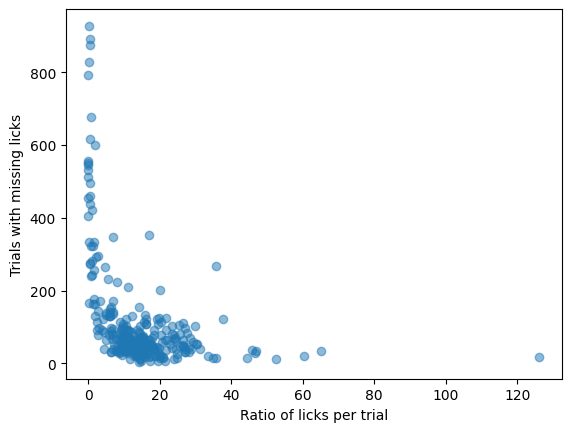

In [4]:
plt.scatter(lick_custom['ratio'], lick_custom['miss_lick_count'], alpha=.5)
plt.xlabel('Ratio of licks per trial')
plt.ylabel('Trials with missing licks')
# plt.xlim([5, 120])

/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/numpy/lib/histograms.py:825: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/numpy/lib/histograms.py:826: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


(array([68., 70., 28., 11.,  1.,  2.,  0.,  1.,  0.,  1.]),
 array([  4. ,  38.8,  73.6, 108.4, 143.2, 178. , 212.8, 247.6, 282.4,
        317.2, 352. ]),
 <BarContainer object of 10 artists>)

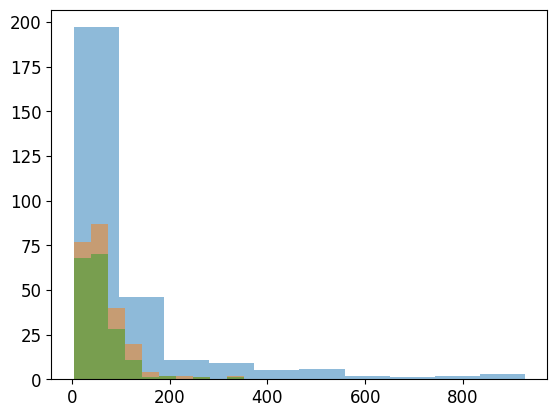

In [220]:
binwidth=10
plt.hist(lick_custom['miss_lick_count'], binwidth, alpha=0.5)
plt.hist(lick_custom.loc[lick_custom['ratio']>5, 'miss_lick_count'], binwidth, alpha=.5)
plt.hist(lick_custom.loc[lick_custom['ratio']>10, 'miss_lick_count'], binwidth, alpha=.5)

/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 37.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 50.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 8.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 36.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ines/miniconda3/envs/ib

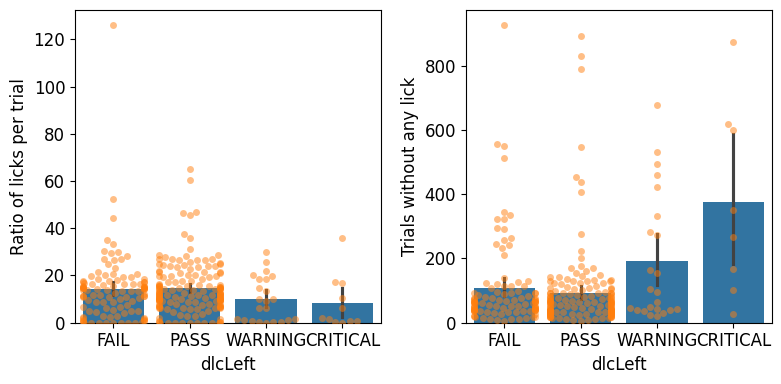

/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 11.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 52.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 17.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 53.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ines/miniconda3/envs/i

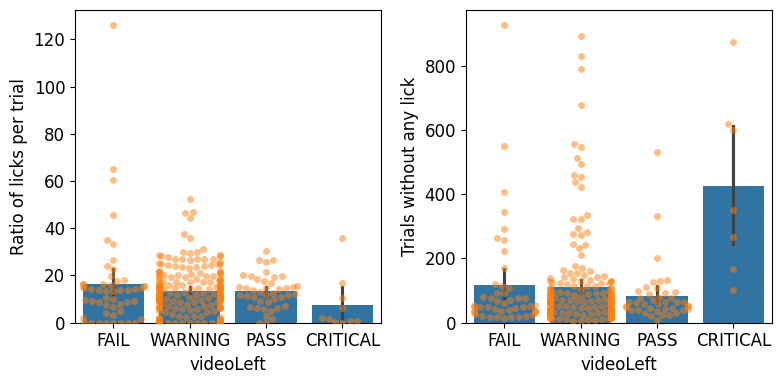

/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 54.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 54.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


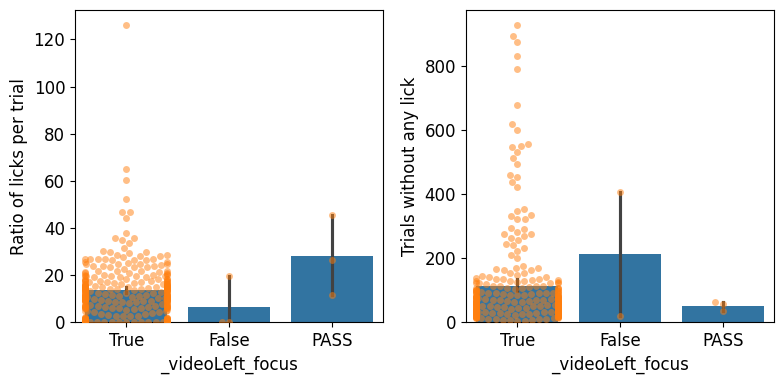

/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 63.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 62.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


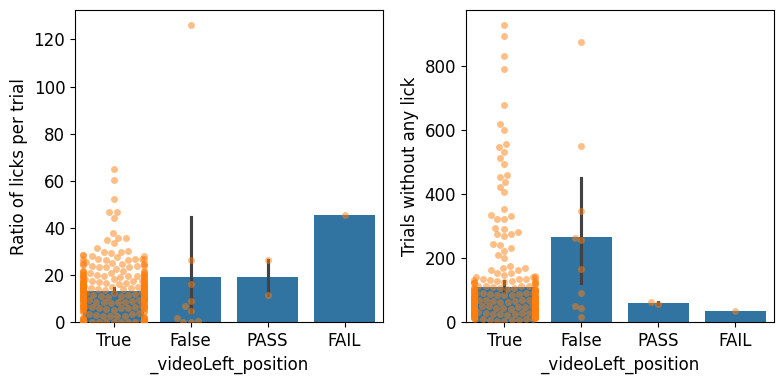

/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 61.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 60.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


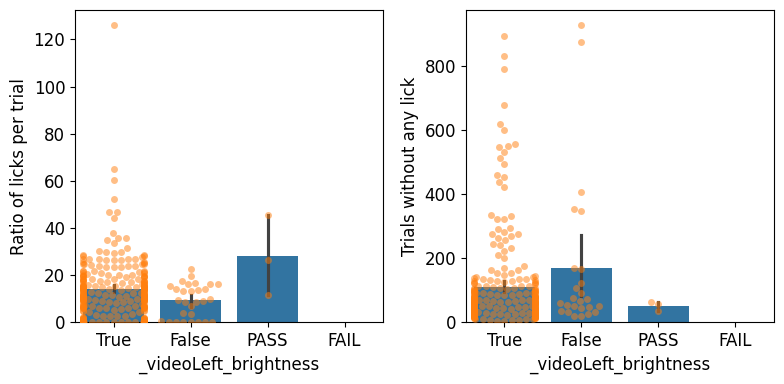

/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 54.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


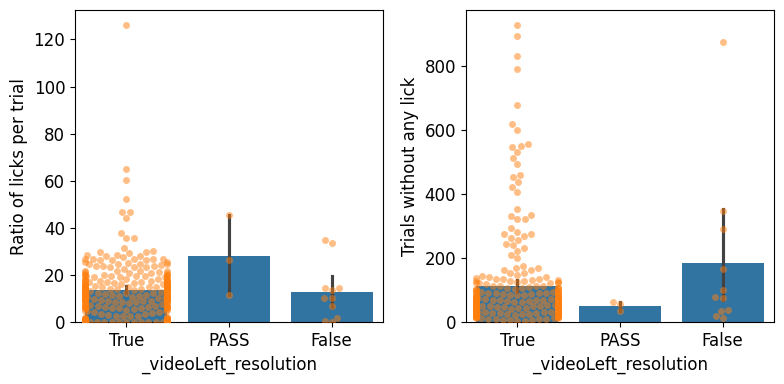

/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 53.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 53.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


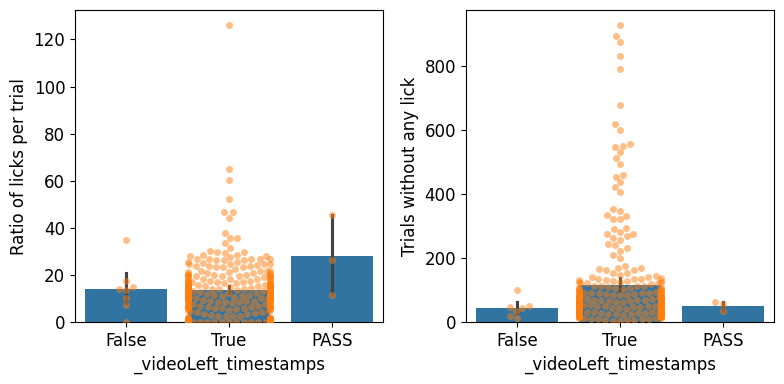

/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 7.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 24.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


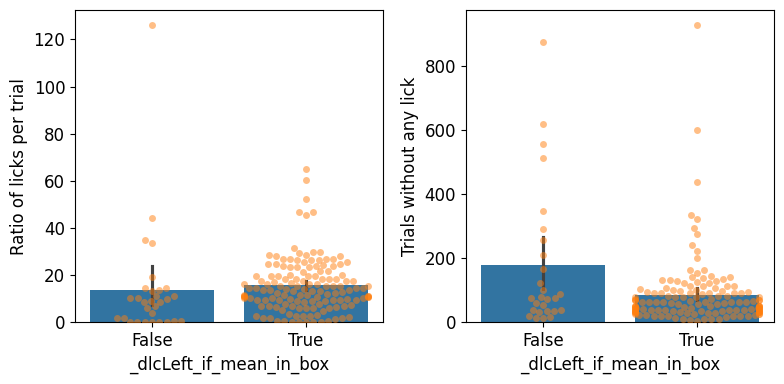

/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 37.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 42.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


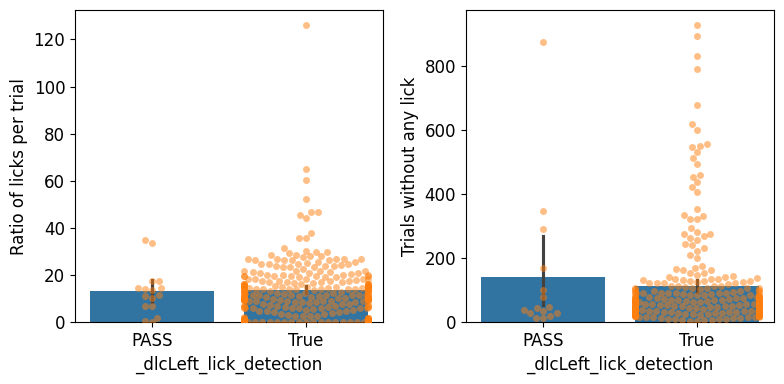

/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 39.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 42.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


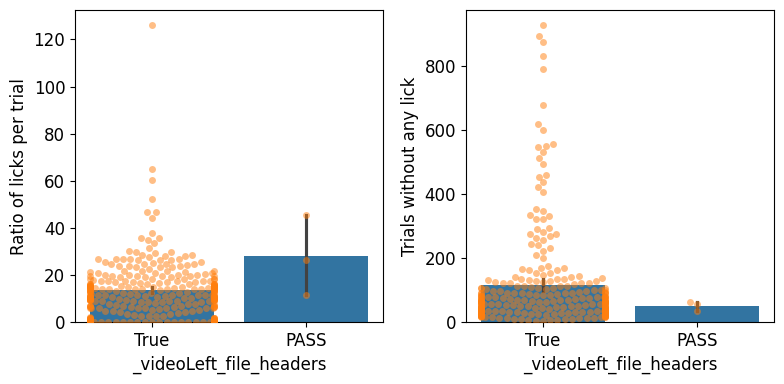

/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 61.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 59.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


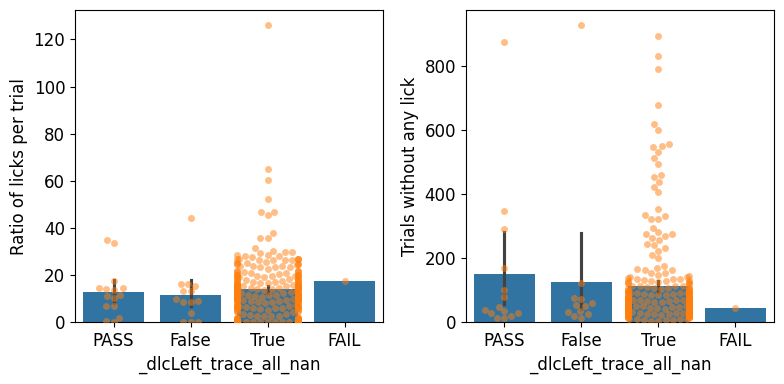

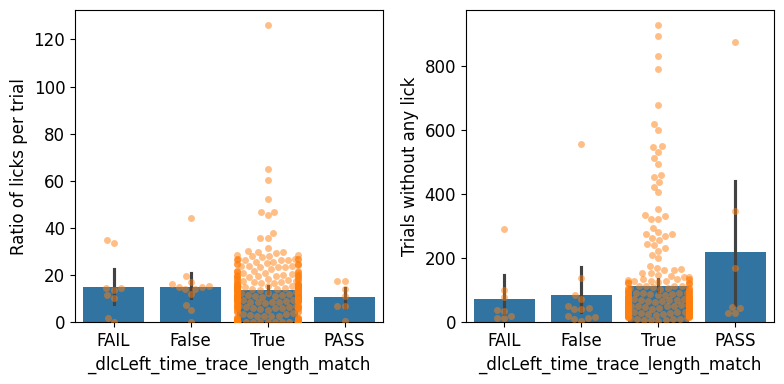

In [163]:
interest_qc = ['dlcLeft', 'videoLeft', '_videoLeft_focus', 
            '_videoLeft_position', 
            '_videoLeft_brightness', '_videoLeft_resolution',
            '_videoLeft_timestamps', '_dlcLeft_if_mean_in_box', '_dlcLeft_lick_detection',
             '_videoLeft_file_headers','_dlcLeft_trace_all_nan', '_dlcLeft_time_trace_length_match']
save_path = '/home/ines/repositories/representation_learning_variability/Video and wheel/Video QC/Figures/'
for var in interest_qc:
    fig, ax = plt.subplots(nrows=1, ncols=2, sharex=False, sharey=False, figsize=[8, 4])
    plt.rc('font', size=12)
    sns.barplot(y='ratio', x=var, data=lick_custom.reset_index(), ax=ax[0])
    sns.swarmplot(y='ratio', x=var, data=lick_custom.reset_index(), alpha=0.5, ax=ax[0])
    ax[0].set_ylabel('Ratio of licks per trial')
    sns.barplot(y='miss_lick_count', x=var, data=lick_custom.reset_index(), ax=ax[1])
    sns.swarmplot(y='miss_lick_count', x=var, data=lick_custom.reset_index(), alpha=0.5, ax=ax[1])
    ax[1].set_ylabel('Trials without any lick')
    plt.tight_layout()
    plt.savefig(str(save_path + var + '.png'), format='png')
        

## Random Forest

In [5]:
# df = lick_custom[['dlcLeft', 'videoLeft', '_videoLeft_focus', 
#             '_videoLeft_position', 
#             '_videoLeft_brightness', '_videoLeft_resolution',
#             '_videoLeft_timestamps', '_dlcLeft_if_mean_in_box', '_dlcLeft_lick_detection',
#              '_videoLeft_file_headers','_dlcLeft_trace_all_nan', '_dlcLeft_time_trace_length_match', 'ratio', 'miss_lick_count']].dropna()

0.6


Text(0, 0.5, 'Feature importance')

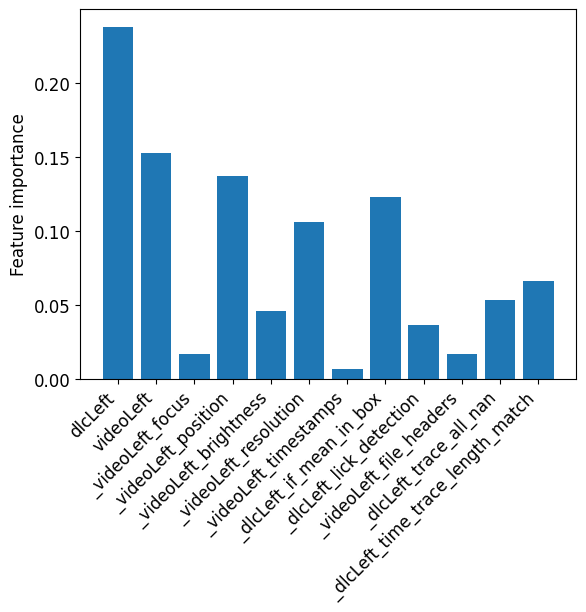

In [206]:
# Transform ratio in binary variable
use_df = df.copy()
use_df.loc[use_df['ratio']<5, 'ratio'] = 0
use_df.loc[use_df['ratio']>=5, 'ratio'] = 1

# Balance dataset
# Separate the majority and minority classes
df_majority = use_df[use_df['ratio'] == 1]  # Majority class
df_minority = use_df[use_df['ratio'] == 0]  # Minority class

# Downsample the majority class
df_majority_downsampled = resample(
    df_majority,
    replace=False,  # Without replacement
    n_samples=len(df_minority),  # Match the minority class size
    random_state=42  # Reproducibility
)

# Combine the downsampled majority class with the minority class
df_balanced = pd.concat([df_majority_downsampled, df_minority])

# Shuffle the dataset to mix the classes
df_balanced = df_balanced.sample(frac=1, random_state=42).reset_index(drop=True)

# Transform into numerical
X_df = df_balanced[['dlcLeft', 'videoLeft', '_videoLeft_focus', 
            '_videoLeft_position', 
            '_videoLeft_brightness', '_videoLeft_resolution',
            '_videoLeft_timestamps', '_dlcLeft_if_mean_in_box', '_dlcLeft_lick_detection',
             '_videoLeft_file_headers','_dlcLeft_trace_all_nan', '_dlcLeft_time_trace_length_match']]

mappings = {col: dict(enumerate(X_df[col].astype('category').cat.categories)) for col in X_df.columns}
inverse_mappings = {col: {v: k for k, v in mappings[col].items()} for col in mappings.keys()}
new_X = X_df.copy()
for col in X_df.columns:
    new_X[col] = new_X[col].map(inverse_mappings[col])
    
X = np.array(new_X.copy())
y = np.array(df_balanced['ratio'].copy())

X = X.astype(float)
y = y.astype(int)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

clf = RandomForestClassifier(max_depth=2, random_state=0)

clf.fit(X_train, y_train)
score = clf.score(X_test, y_test, sample_weight=None)
print(score) 

feature_importances = clf.feature_importances_
plt.bar(np.array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11]), feature_importances)
plt.xticks([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11], np.array(new_X.keys()))
plt.xticks(rotation=45, ha='right')
plt.ylabel('Feature importance')


## Ven diagrams for different QCs

In [7]:
filtered = lick_custom.loc[(lick_custom['ratio']>5) & (lick_custom['miss_lick_count']<100)]
filtered1 = lick_custom.loc[(lick_custom['ratio']>5)]
filtered2 = lick_custom.loc[(lick_custom['dlcLeft'].isin(['PASS', 'WARNING', 'CRITICAL'])) &
                            (lick_custom['videoLeft'].isin(['PASS', 'WARNING', 'CRITICAL']))]
intersection = np.intersect1d(filtered['eid'], filtered2['eid'])
print('Non filtered dataset: ' + str(len(lick_custom)))
print('> 5 ratio and < 100 missing: ' + str(len(filtered)))
print('> 5 ratio ' + str(len(filtered1)))
print('Pass dlc and video: ' + str(len(filtered2)))
print('All of the above: ' + str(len(intersection)))

Non filtered dataset: 308
> 5 ratio and < 100 missing: 194
> 5 ratio 236
Pass dlc and video: 178
All of the above: 143


In [35]:
exclude_sessions = ['f1db6257-85ef-4385-b415-2d078ec75df2',
'259927fd-7563-4b03-bc5d-17b4d0fa7a55',
'e49d8ee7-24b9-416a-9d04-9be33b655f40',
'6f6d2c8e-28be-49f4-ae4d-06be2d3148c1',
'193fe7a8-4eb5-4f3e-815a-0c45864ddd77',
'f8d5c8b0-b931-4151-b86c-c471e2e80e5d',
'ebc9392c-1ecb-4b4b-a545-4e3d70d23611',
'537677fe-1e24-4755-948c-fa4a4e8ecce5',
'a4747ac8-6a75-444f-b99b-696fff0243fd',
'7be8fec4-406b-4e74-8548-d2885dcc3d5e',
'a71175be-d1fd-47a3-aa93-b830ea3634a1',
'53738f95-bd08-4d9d-9133-483fdb19e8da',
'd901aff5-2250-467a-b4a1-0cb9729df9e2',
'7939711b-8b4d-4251-b698-b97c1eaa846e',
'510b1a50-825d-44ce-86f6-9678f5396e02',
'aad23144-0e52-4eac-80c5-c4ee2decb198',
'd839491f-55d8-4cbe-a298-7839208ba12b',
'72cb5550-43b4-4ef0-add5-e4adfdfb5e02']


<Axes: >

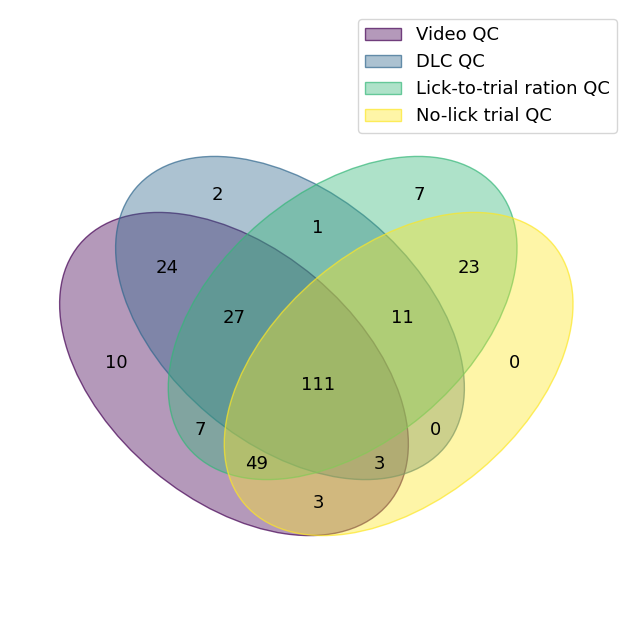

In [58]:

miss = lick_custom.loc[(lick_custom['miss_lick_count']<100), 'eid']
ratio_miss = lick_custom.loc[(lick_custom['ratio']>5) & (lick_custom['miss_lick_count']<100), 'eid']
ratio = lick_custom.loc[(lick_custom['ratio']>5), 'eid']
video_dlc = lick_custom.loc[(lick_custom['dlcLeft'].isin(['PASS', 'WARNING'])) &
                            (lick_custom['videoLeft'].isin(['PASS', 'WARNING']))]
video = lick_custom.loc[(lick_custom['videoLeft'].isin(['PASS', 'WARNING'])), 'eid']
dlc = lick_custom.loc[(lick_custom['dlcLeft'].isin(['PASS', 'WARNING'])), 'eid']

datas = {
   "Video QC": set(video),
    "DLC QC": set(dlc),
    "Lick-to-trial ration QC": set(ratio),
    "No-lick trial QC": set(miss)
    } #     "Bad fits": set(exclude_sessions)

venn(datas) 

# Plot PSTHs of interest

In [4]:
def plot_licks_PSTH(eid, lick_custom, save_path):
    
    leftVideo_qc = list(lick_custom.loc[lick_custom['eid']==eid, 'videoLeft'])[0]
    leftDLC_qc = list(lick_custom.loc[lick_custom['eid']==eid, 'dlcLeft'])[0]
    missing_licks = list(lick_custom.loc[lick_custom['eid']==eid, 'miss_lick_count'])[0]
    lick_ratio = list(lick_custom.loc[lick_custom['eid']==eid, 'ratio'])[0]

    # # Get PSTH
    # data = list(psth_df.loc[psth_df['eid']==eid, 'licks_trial'])
    
    # Get lick times for sessions
    lick_times = get_lick_times(one, eid, video_type = 'left')

    # Get trials for corresponding session
    trials = one.load_object(eid, obj='trials', namespace='ibl')
    trial_df = trials.to_df()
    
    data = lick_psth(trial_df, lick_times, 1, 2, event='feedback_times')
    
    
    if len(data) > 0:
        # data = data[0]
        trials = data['trial']
        num_trials = int(np.max(trials))
        # Plot data
        fig, ax = plt.subplots(nrows=1, ncols=1, sharex=False, sharey=True, figsize=[9, 5])
        for t, trial in enumerate(range(num_trials)):
            licks_correct = np.array(data.loc[(data['trial']==t) & (data['correct']==1), 'lick_times'])
            licks_incorrect = np.array(data.loc[(data['trial']==t) & (data['correct']==-1), 'lick_times'])
            ax.scatter(licks_correct, np.full_like(licks_correct, t), color='green', s=1)
            ax.scatter(licks_incorrect, np.full_like(licks_incorrect, t), color='red', s=1)
        ax.set_title('Video_qc: ' + str(leftVideo_qc)+' DLC_qc: ' + str(leftDLC_qc)+ 
                     '\n Lick/trial ratio: '+str(lick_ratio)+
                     '\n Lick-null trials: '+str(missing_licks)
            )
        ax.set_xlabel('Time from feedback')
        ax.set_ylabel('Trial')
        plt.savefig(str(save_path + eid + 'lick_psth_-12_feedback.png'), format='png')
        plt.show()
        
    else:
        print('No PSTH for session ' + eid)

/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


Could not plot for ebe2efe3-e8a1-451a-8947-76ef42427cc9


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

No PSTH for session 5569f363-0934-464e-9a5b-77c8e67791a1
5569f363-0934-464e-9a5b-77c8e67791a1


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

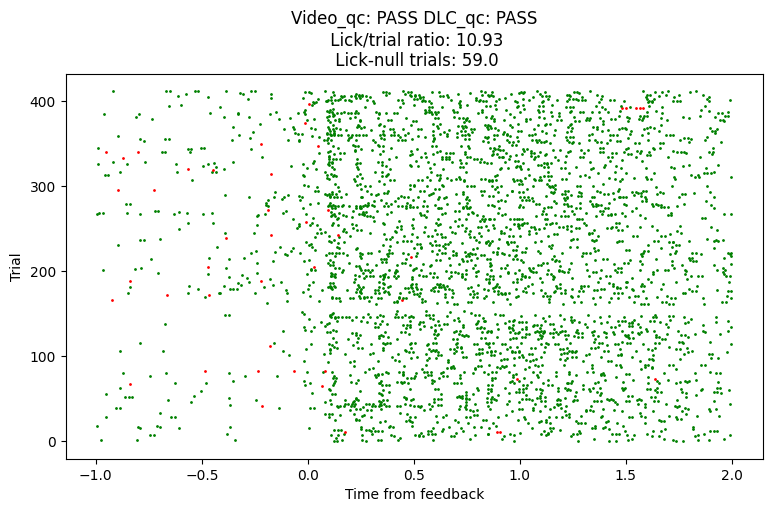

d32876dd-8303-4720-8e7e-20678dc2fd71


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

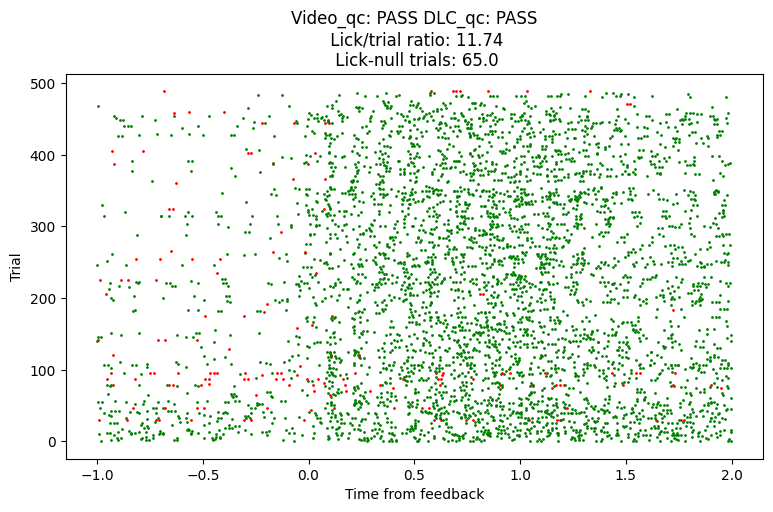

72982282-e493-45ee-87ce-aa45cb3a3ec1


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

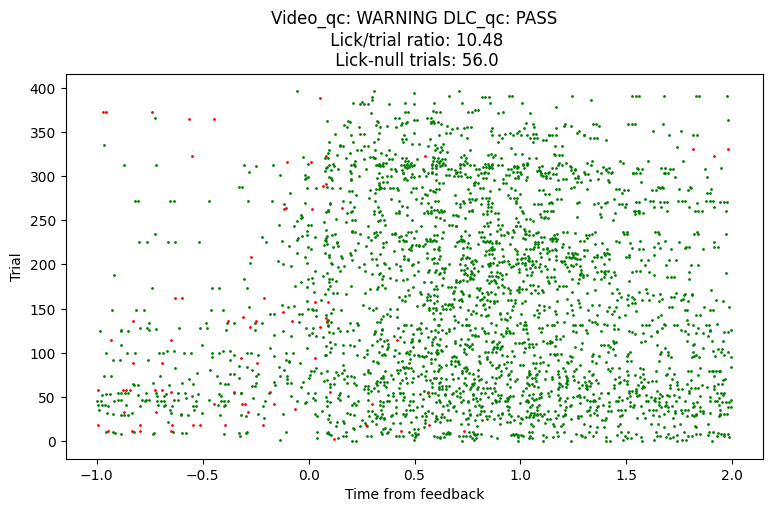

6434f2f5-6bce-42b8-8563-d93d493613a2


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

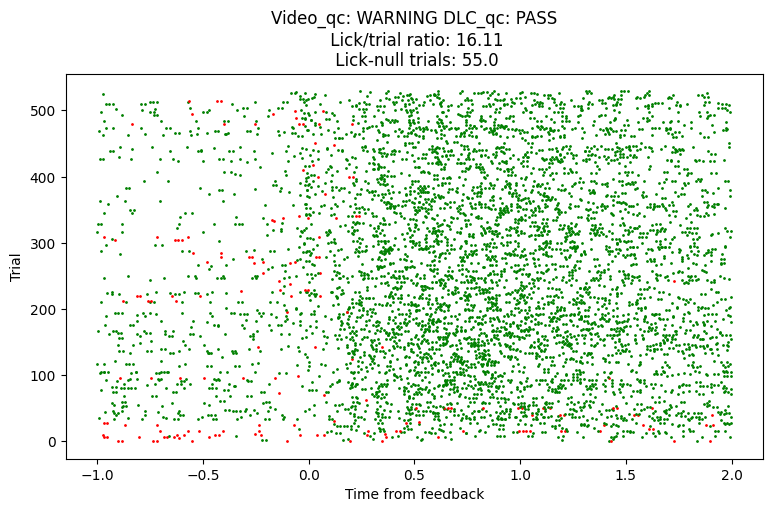

64e3fb86-928c-4079-865c-b364205b502e


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

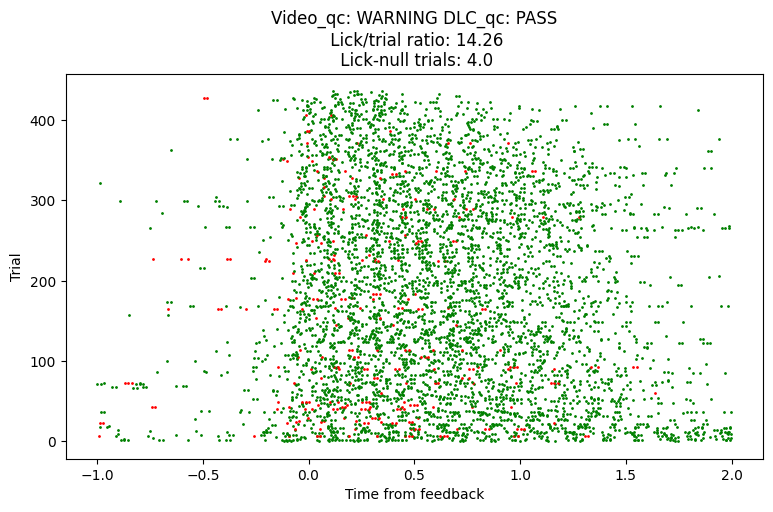

15948667-747b-4702-9d53-354ac70e9119


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

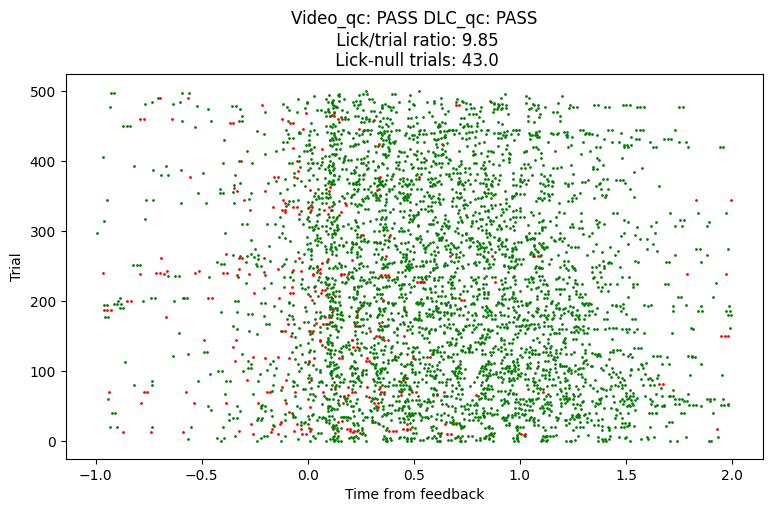

288bfbf3-3700-4abe-b6e4-130b5c541e61


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

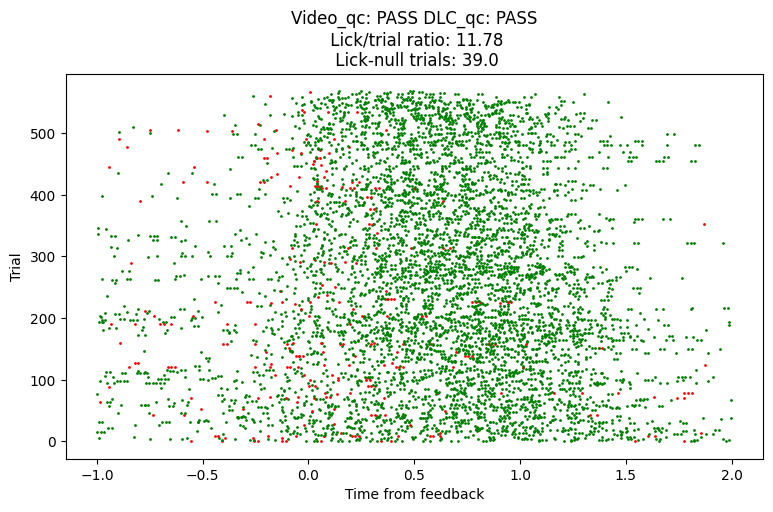

fc43390d-457e-463a-9fd4-b94a0a8b48f5


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

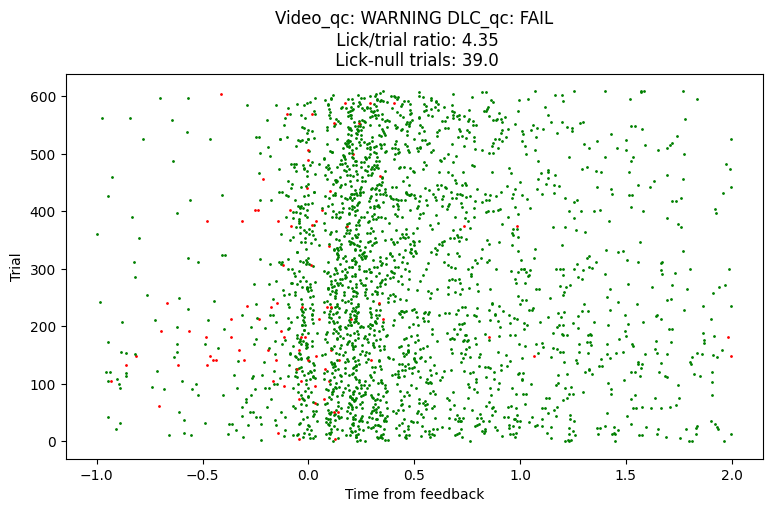

a405053a-eb13-4aa4-850c-5a337e5dc7fd


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

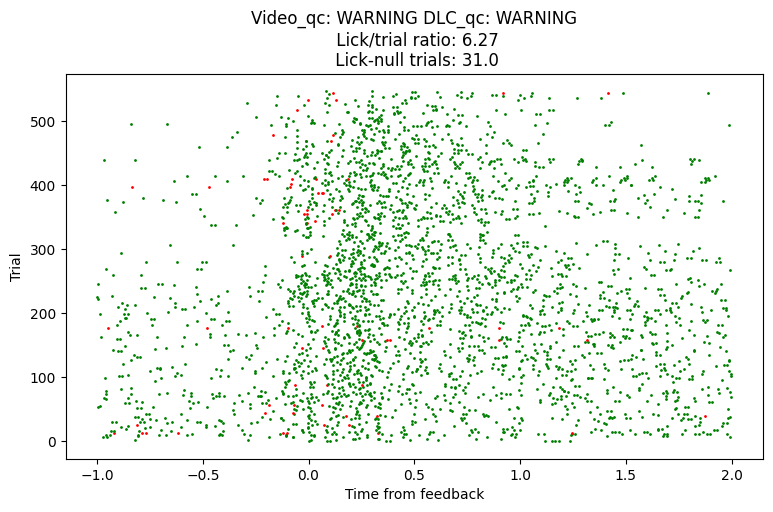

93ad879a-aa42-4150-83e1-38773c9785e4


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

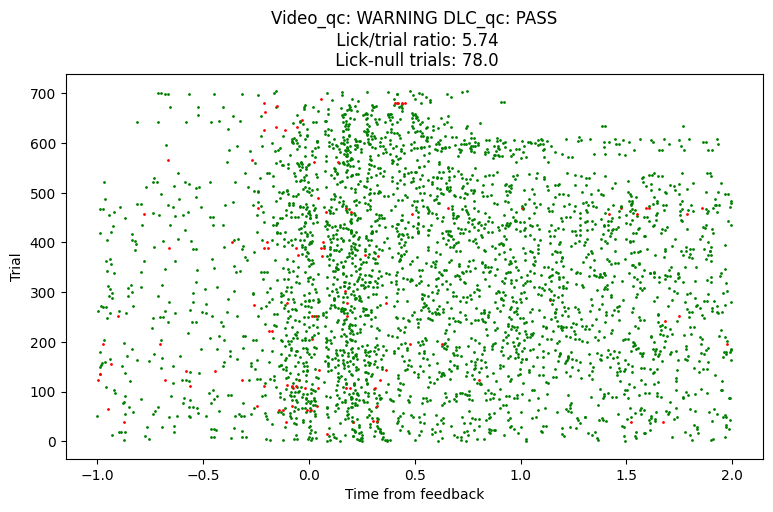

3d59aa1a-b4ba-47fe-b9cf-741b5fdb0c7b


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

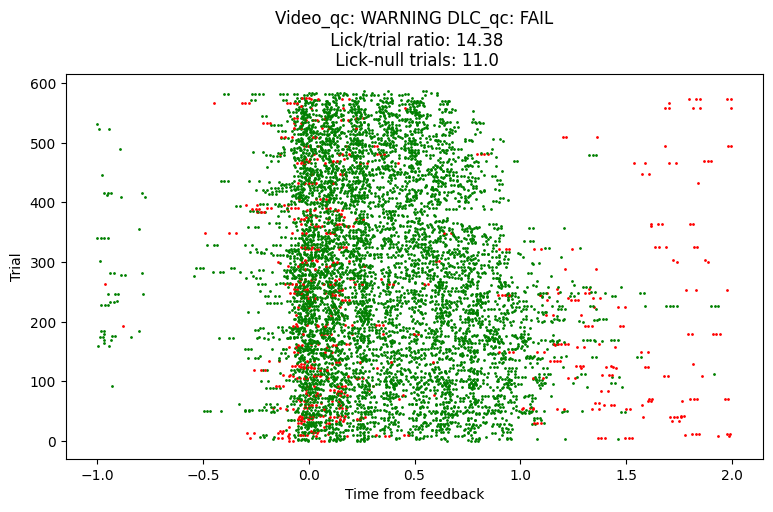

034e726f-b35f-41e0-8d6c-a22cc32391fb


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

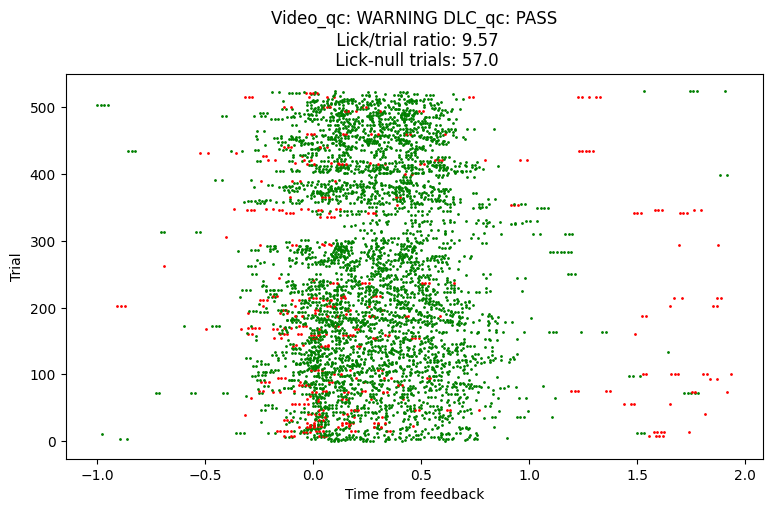

dfd8e7df-dc51-4589-b6ca-7baccfeb94b4


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

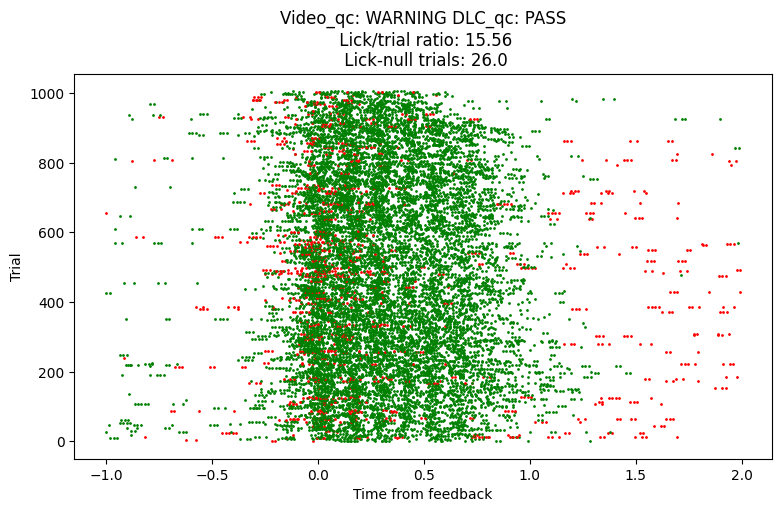

fa704052-147e-46f6-b190-a65b837e605e


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

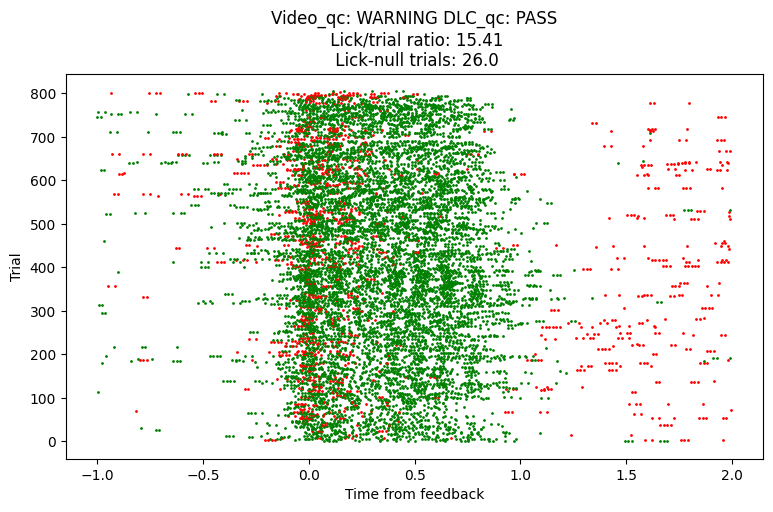

46794e05-3f6a-4d35-afb3-9165091a5a74


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

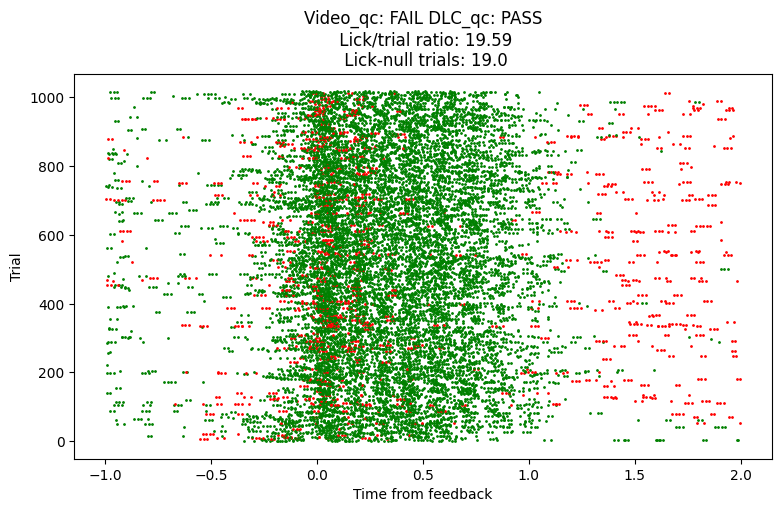

7939711b-8b4d-4251-b698-b97c1eaa846e


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

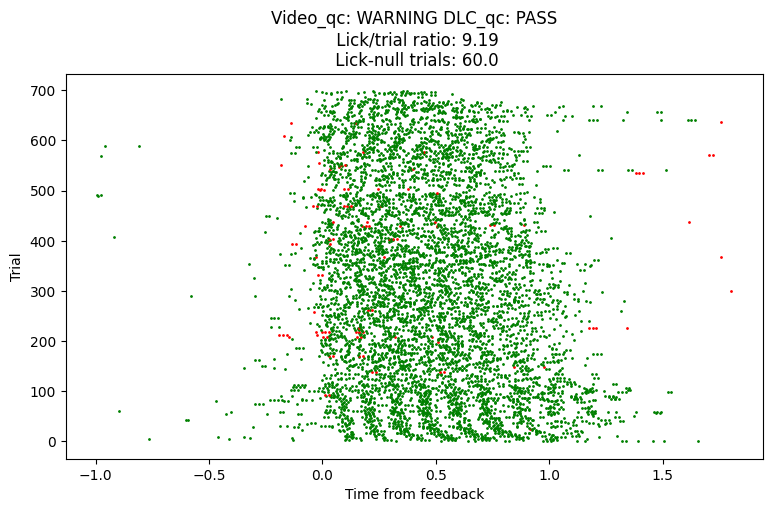

b52182e7-39f6-4914-9717-136db589706e


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

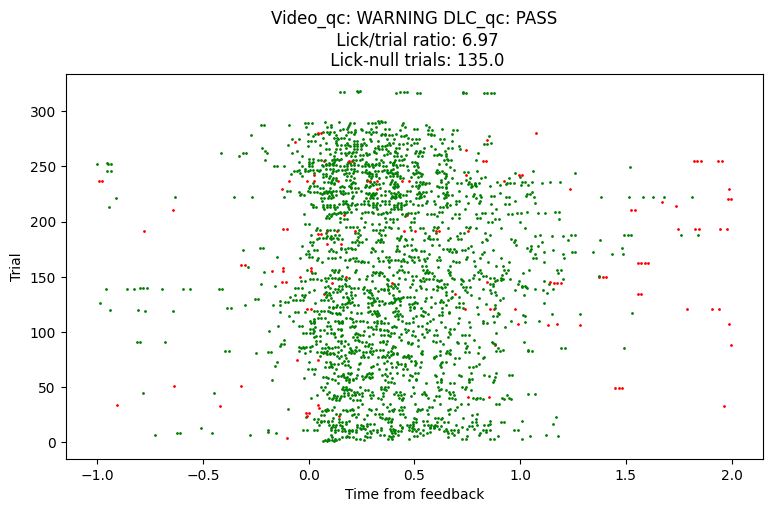

2d5f6d81-38c4-4bdc-ac3c-302ea4d5f46e


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

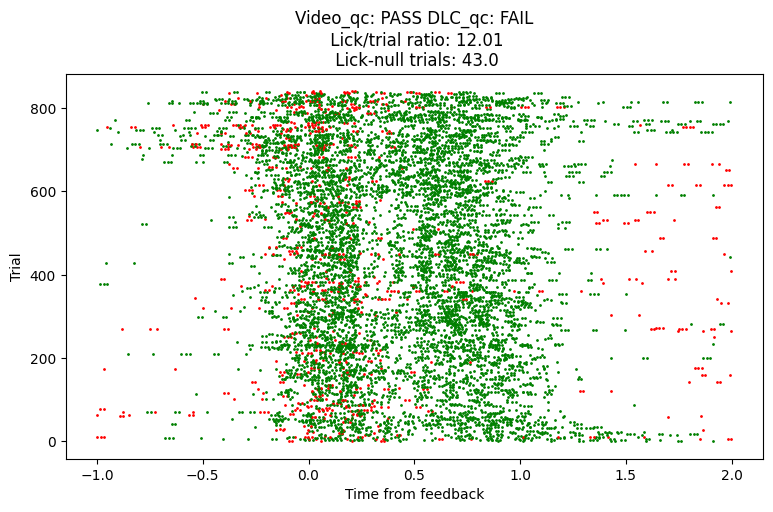

4b7fbad4-f6de-43b4-9b15-c7c7ef44db4b


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

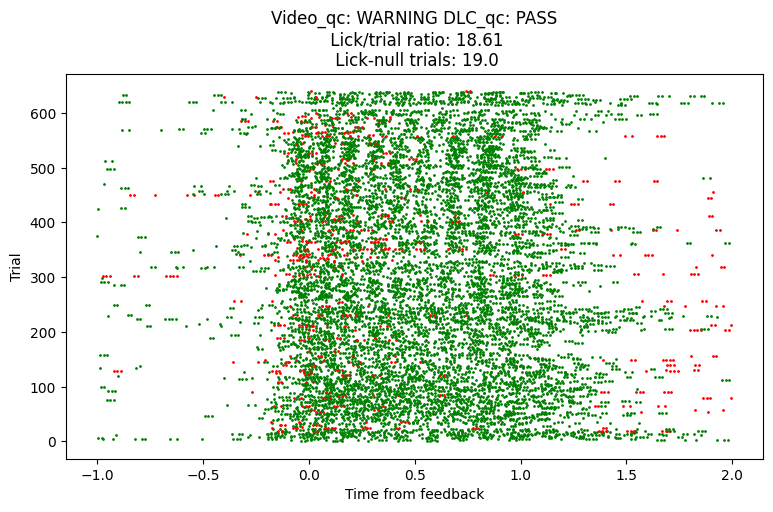

c99d53e6-c317-4c53-99ba-070b26673ac4


local md5 mismatch on dataset: churchlandlab/Subjects/CSHL049/2020-01-11/001/alf/_ibl_trials.stimOff_times.npy


Downloading: /home/ines/Downloads/ONE/alyx.internationalbrainlab.org/churchlandlab/Subjects/CSHL049/2020-01-11/001/alf/_ibl_trials.stimOff_times.c07b94b4-18c6-4940-9bd6-9661f4ae5ceb.npy Bytes: 4600


100%|██████████| 0.00438690185546875/0.00438690185546875 [00:00<00:00,  1.02s/it]
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.appe

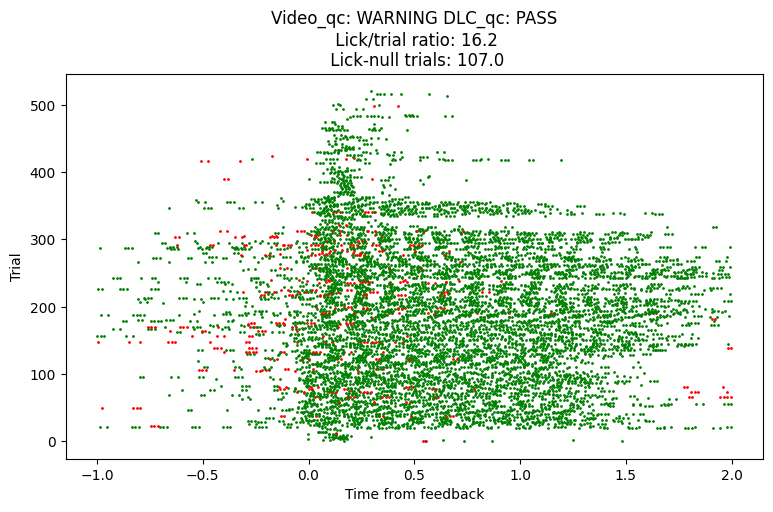

d839491f-55d8-4cbe-a298-7839208ba12b


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

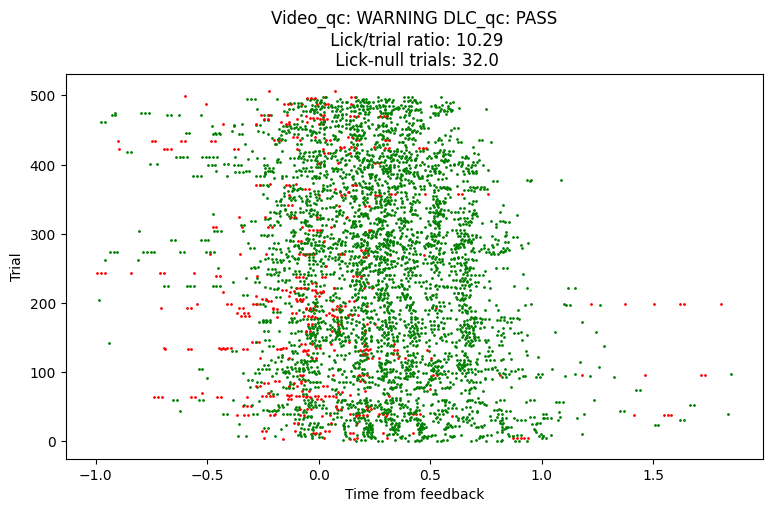

ecb5520d-1358-434c-95ec-93687ecd1396


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

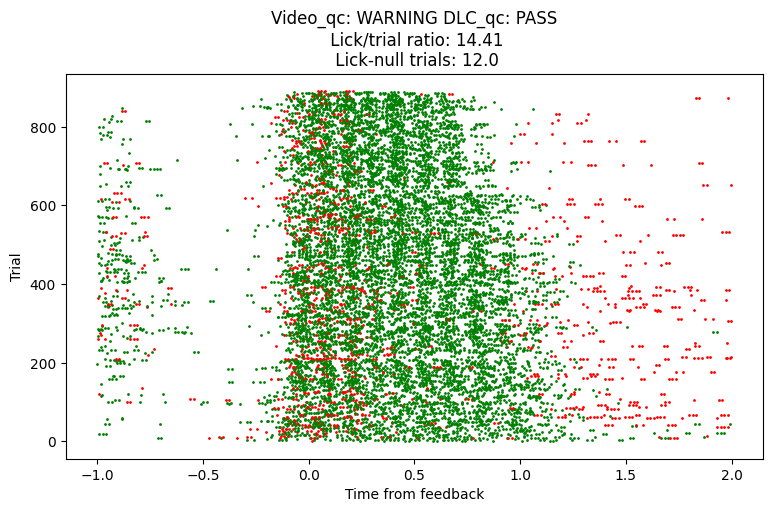

3663d82b-f197-4e8b-b299-7b803a155b84


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

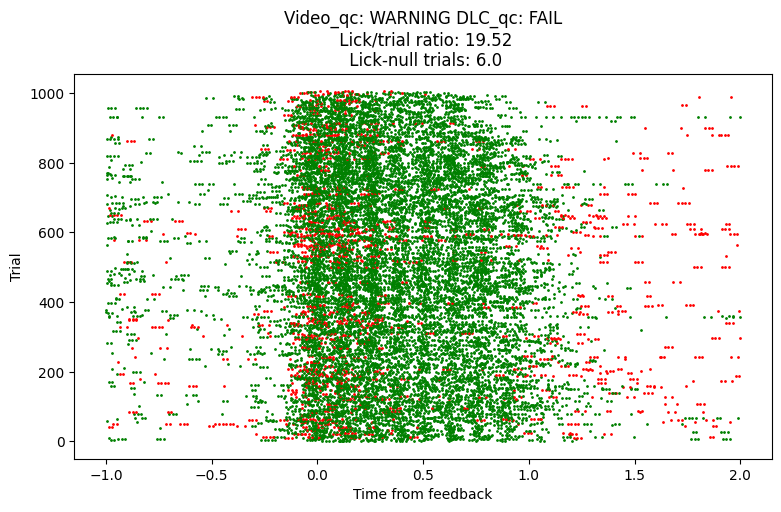

5386aba9-9b97-4557-abcd-abc2da66b863


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

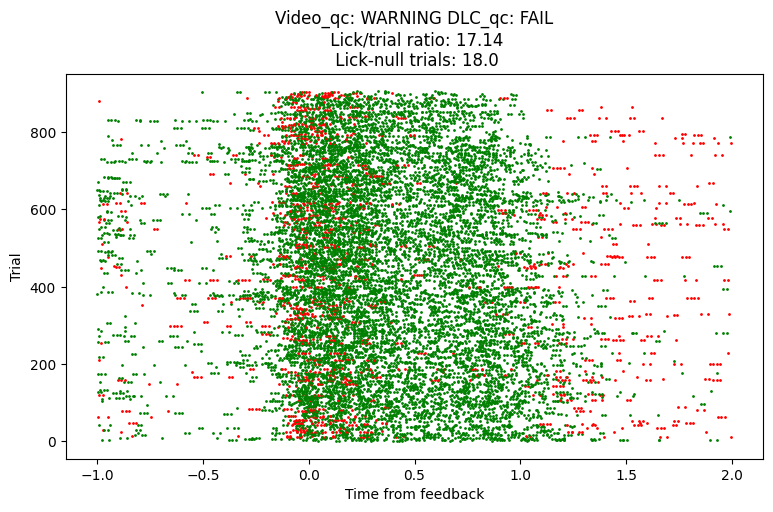

83e77b4b-dfa0-4af9-968b-7ea0c7a0c7e4


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

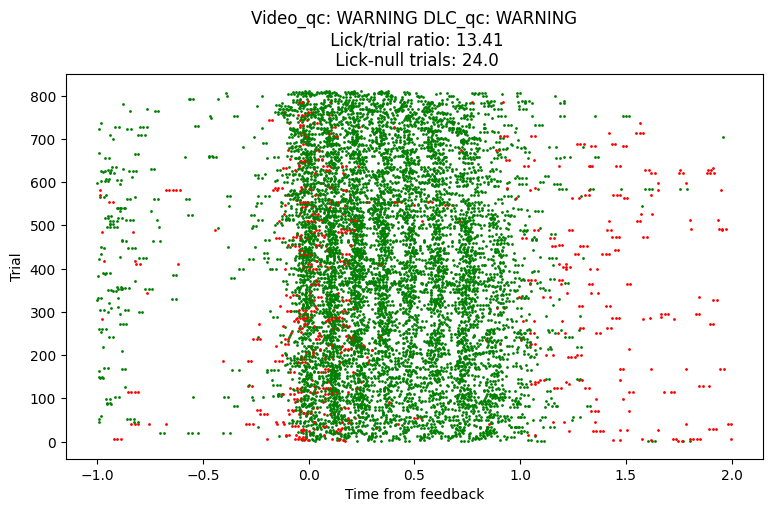

4b00df29-3769-43be-bb40-128b1cba6d35


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

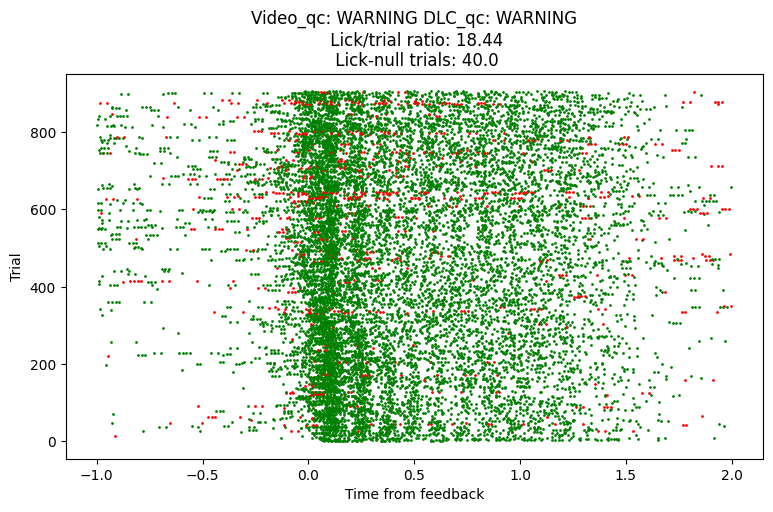

12dc8b34-b18e-4cdd-90a9-da134a9be79c


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

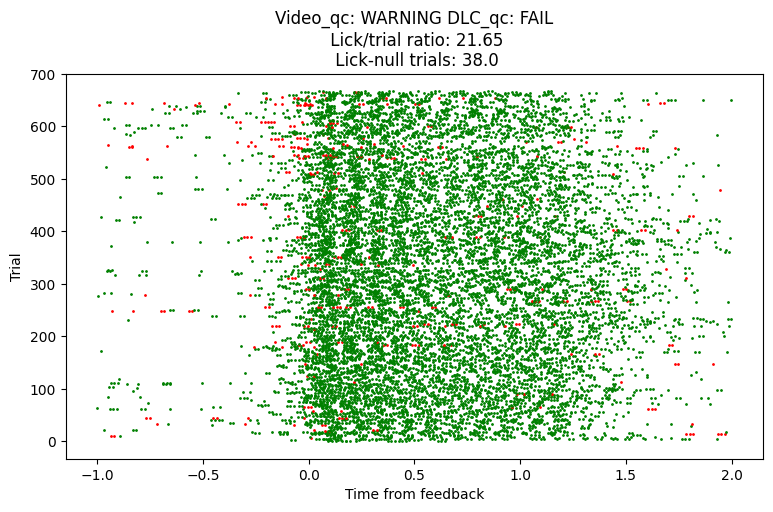

0deb75fb-9088-42d9-b744-012fb8fc4afb


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

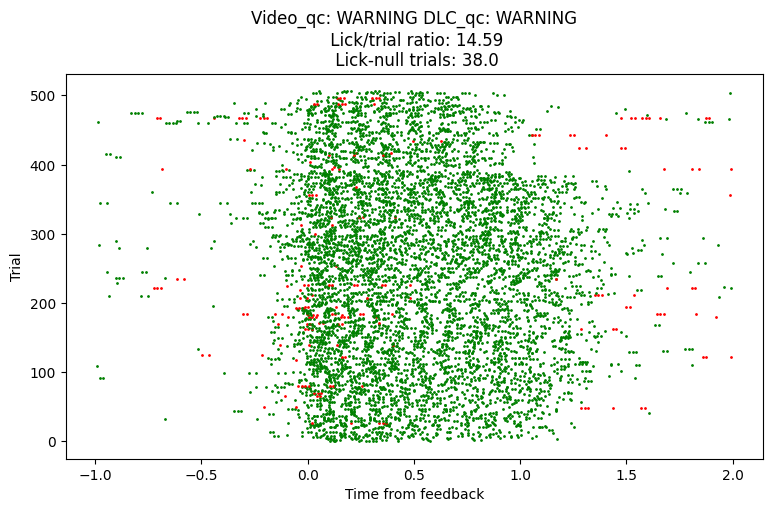

eef82e27-c20e-48da-b4b7-c443031649e3


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

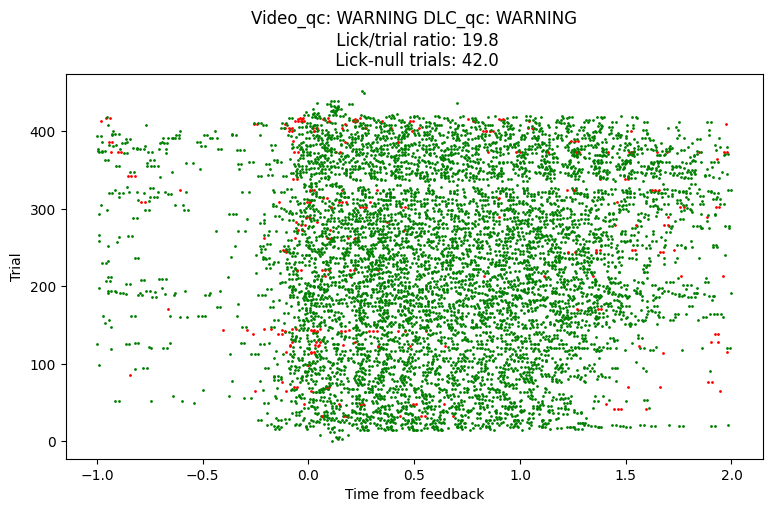

810b1e07-009e-4ebe-930a-915e4cd8ece4


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

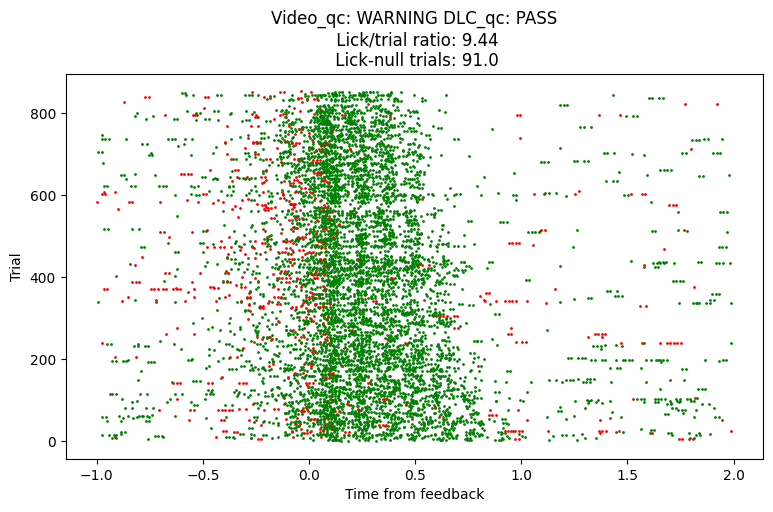

a71175be-d1fd-47a3-aa93-b830ea3634a1


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

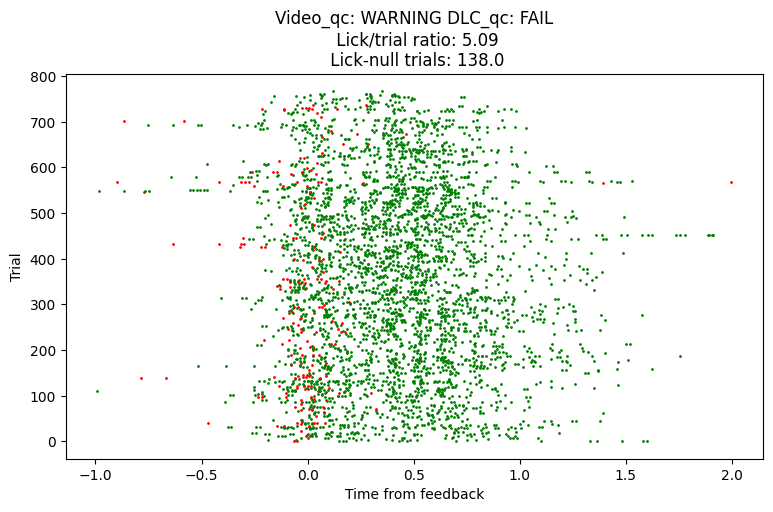

0cbeae00-e229-4b7d-bdcc-1b0569d7e0c3


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

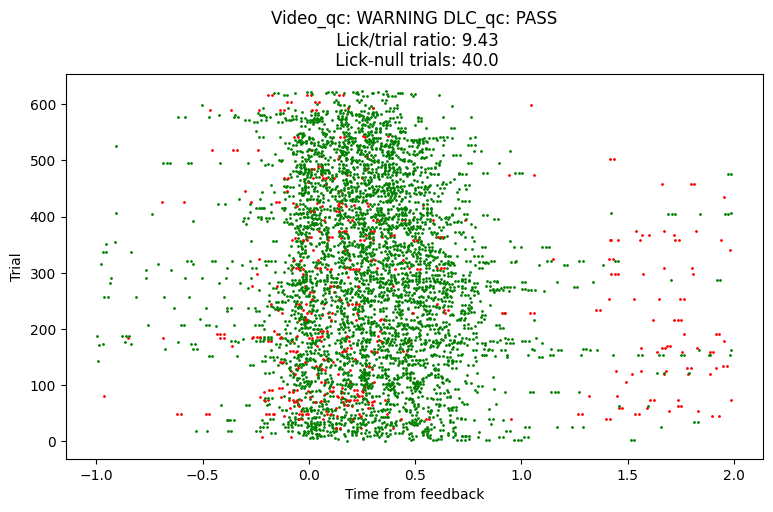

f312aaec-3b6f-44b3-86b4-3a0c119c0438


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

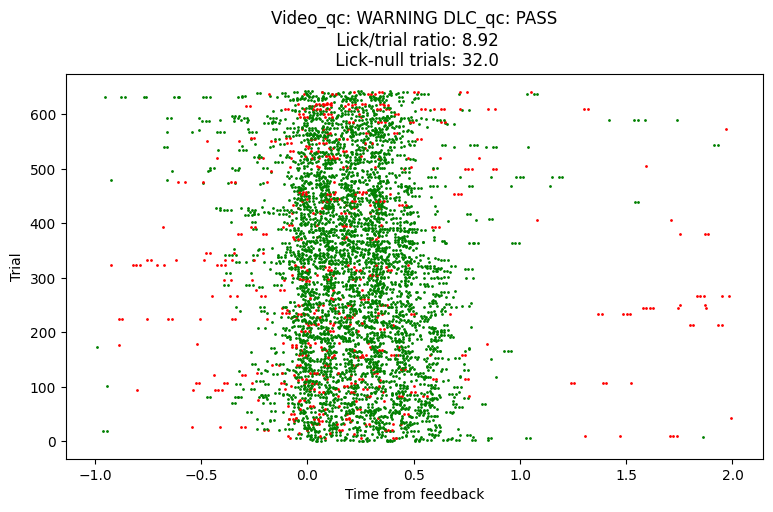

fb70ebf7-8175-42b0-9b7a-7c6e8612226e


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

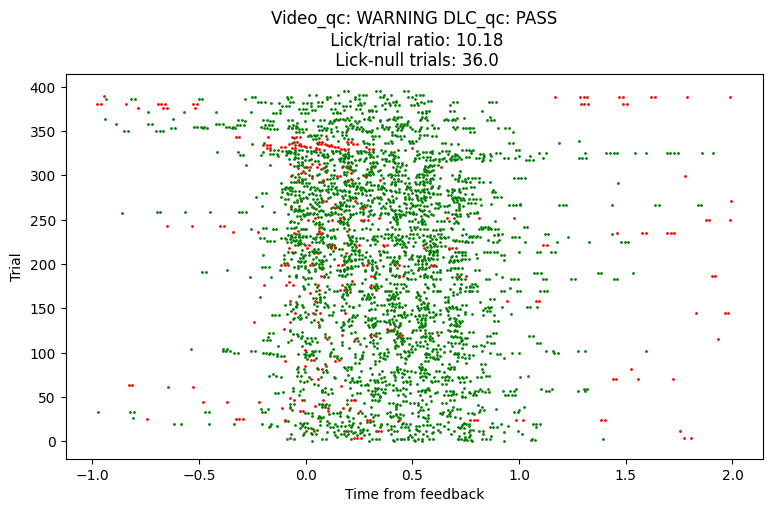

28741f91-c837-4147-939e-918d38d849f2


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

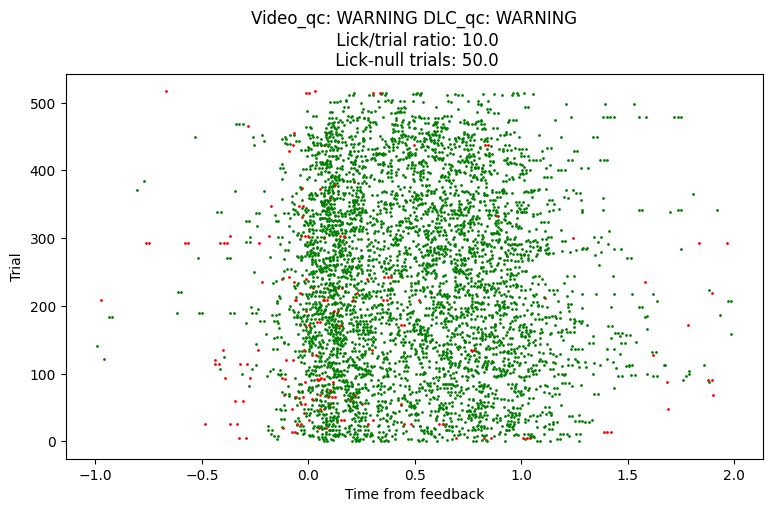

d2f5a130-b981-4546-8858-c94ae1da75ff


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

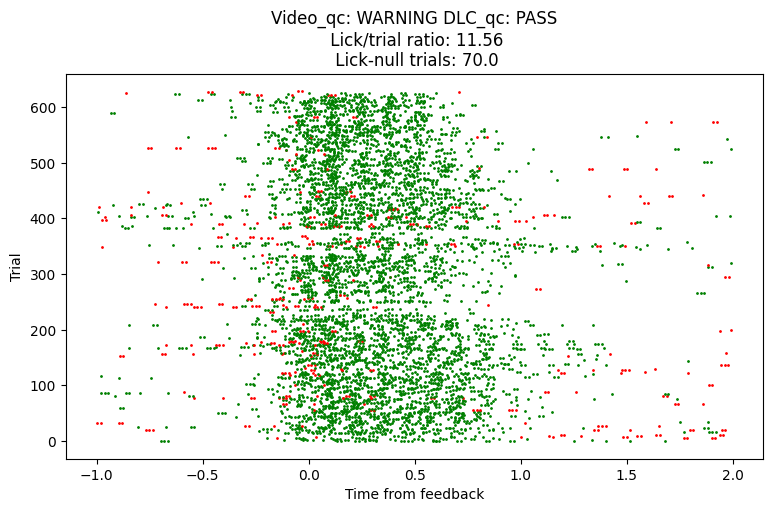

57b5ae8f-d446-4161-b439-b191c5e3e77b


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

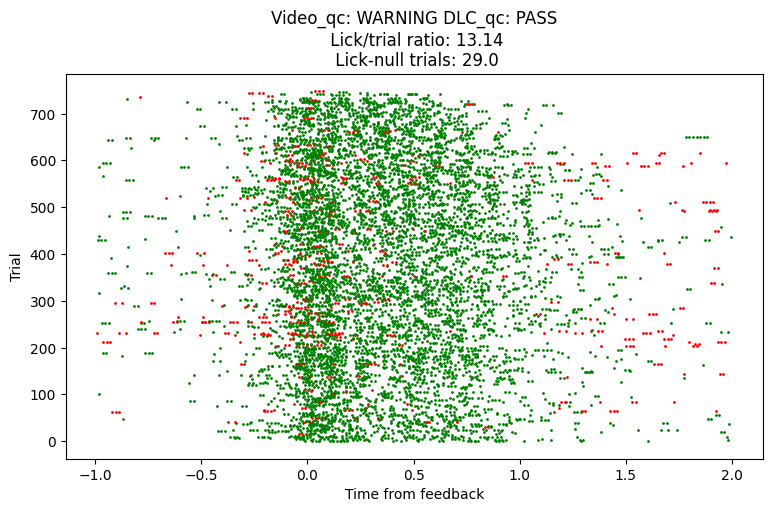

dda5fc59-f09a-4256-9fb5-66c67667a466


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

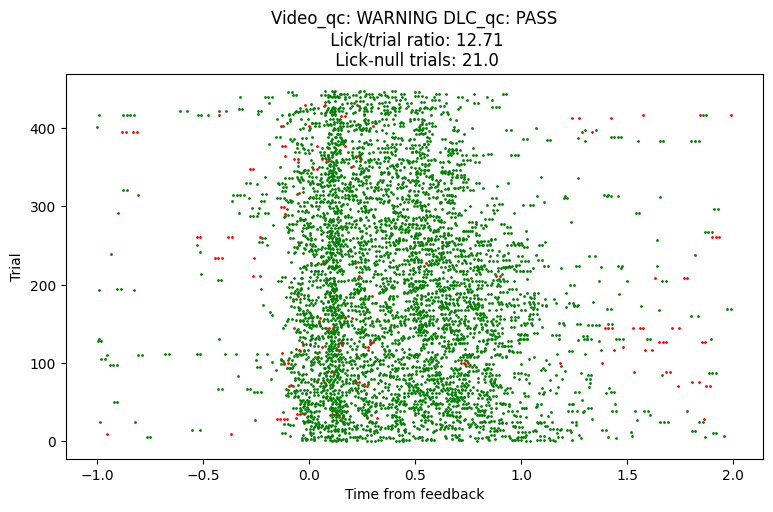

d16a9a8d-5f42-4b49-ba58-1746f807fcc1


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

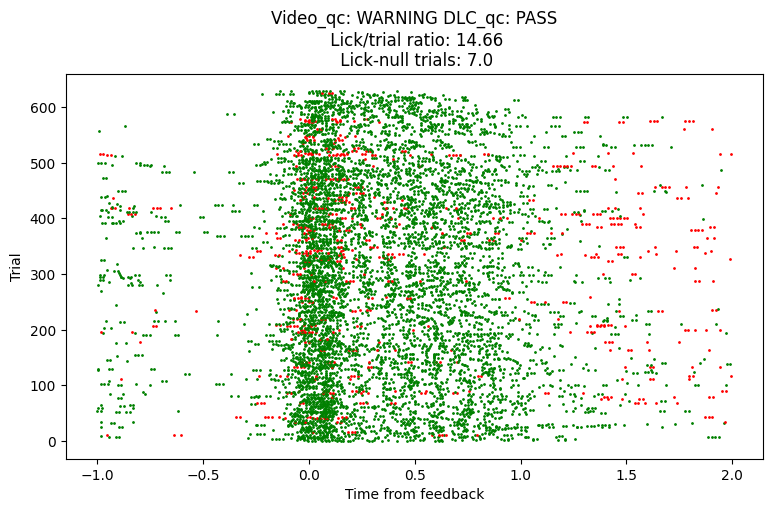

37e96d0b-5b4b-4c6e-9b29-7edbdc94bbd0


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

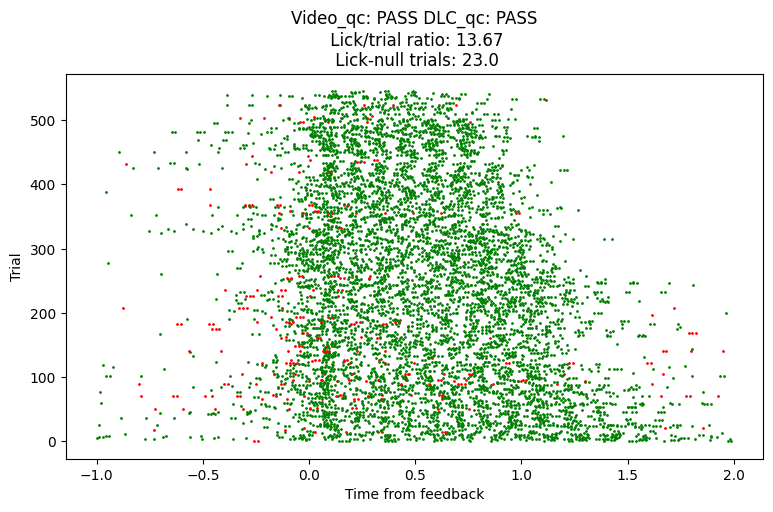

2e6e179c-fccc-4e8f-9448-ce5b6858a183


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

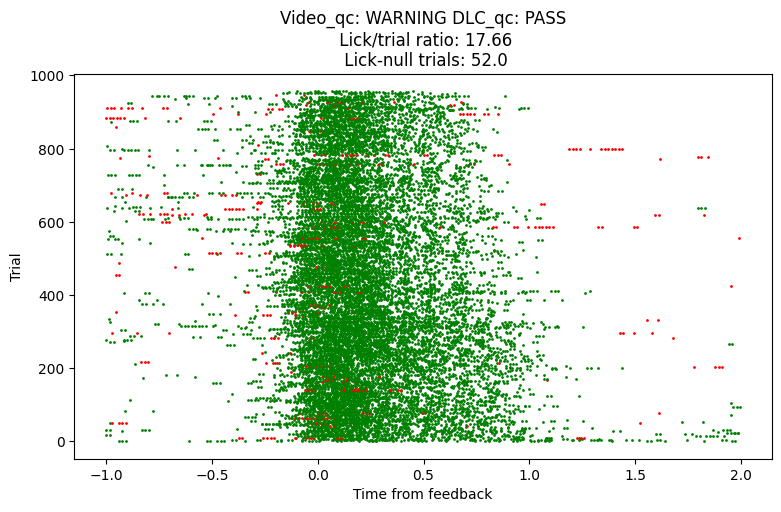

1191f865-b10a-45c8-9c48-24a980fd9402


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

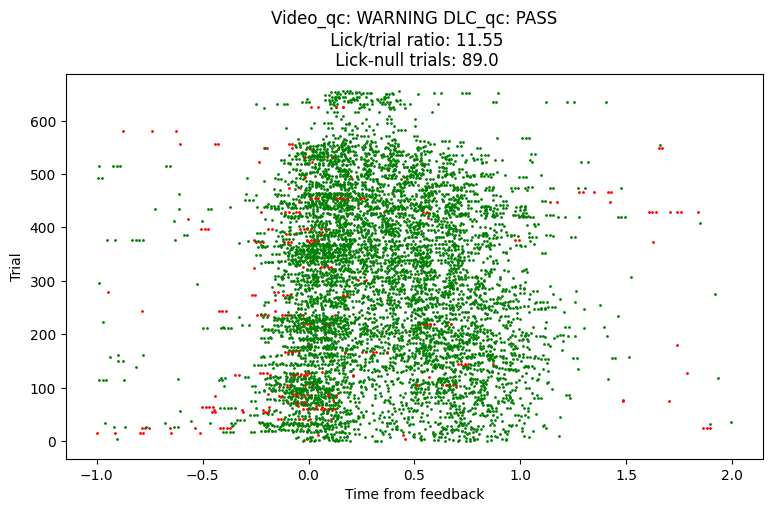

f10efe41-0dc0-44d0-8f26-5ff68dca23e9


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

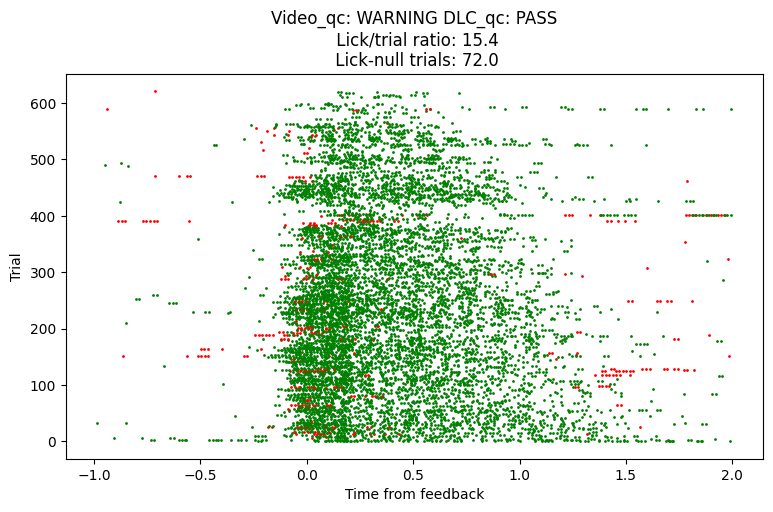

6364ff7f-6471-415a-ab9e-632a12052690


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

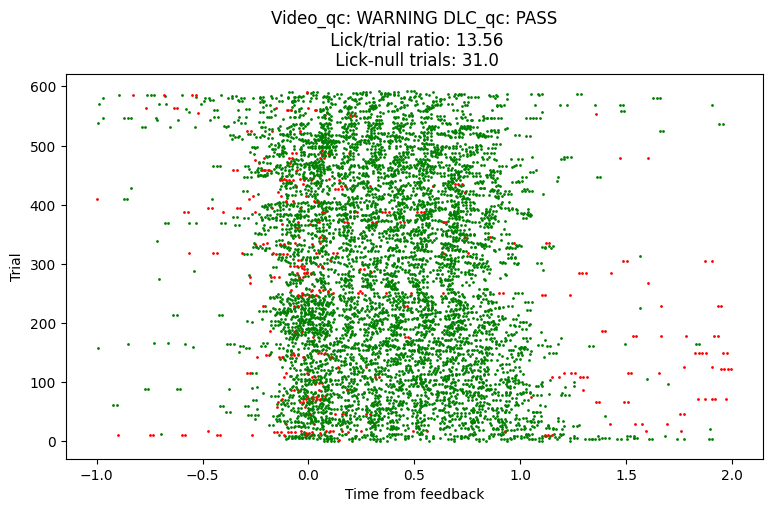

7be8fec4-406b-4e74-8548-d2885dcc3d5e


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

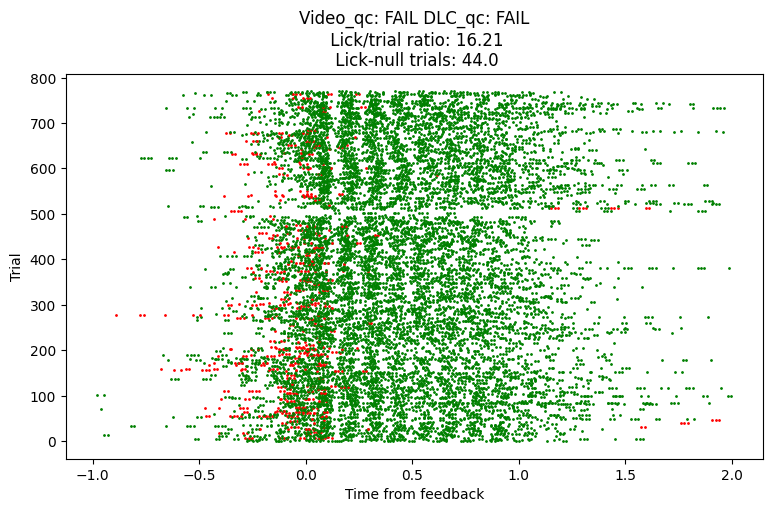

d57df551-6dcb-4242-9c72-b806cff5613a


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

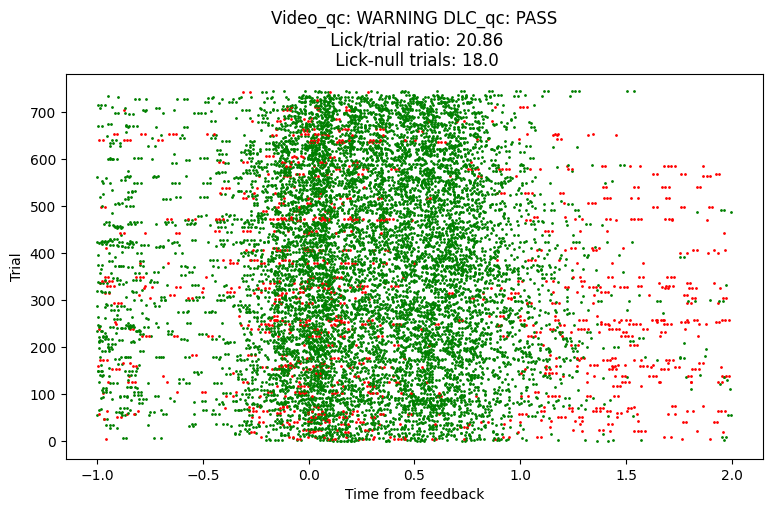

19e66dc9-bf9f-430b-9d6a-acfa85de6fb7


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

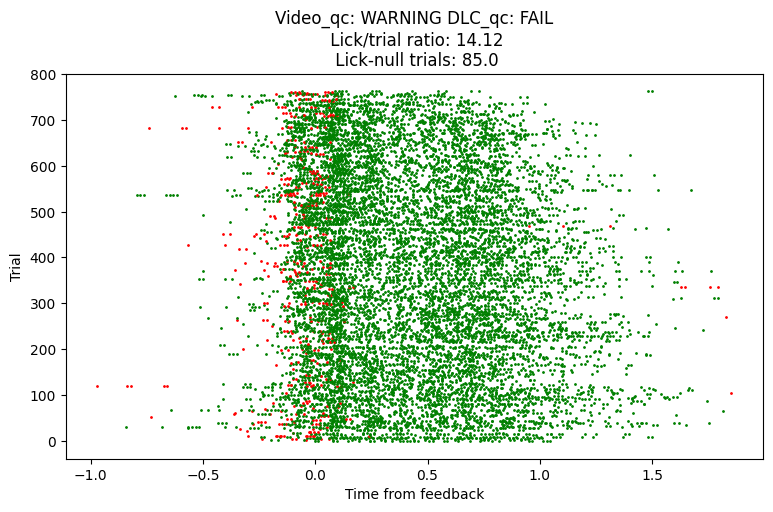

824cf03d-4012-4ab1-b499-c83a92c5589e


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

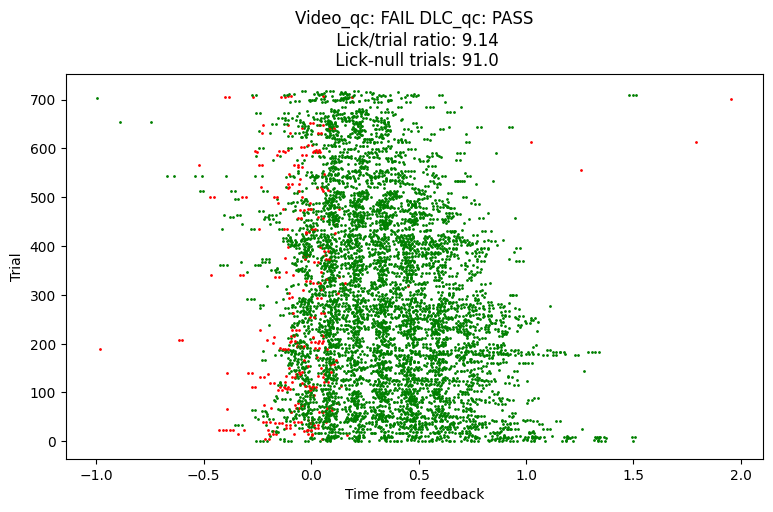

1f095590-6669-46c9-986b-ccaf0620c5e9


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

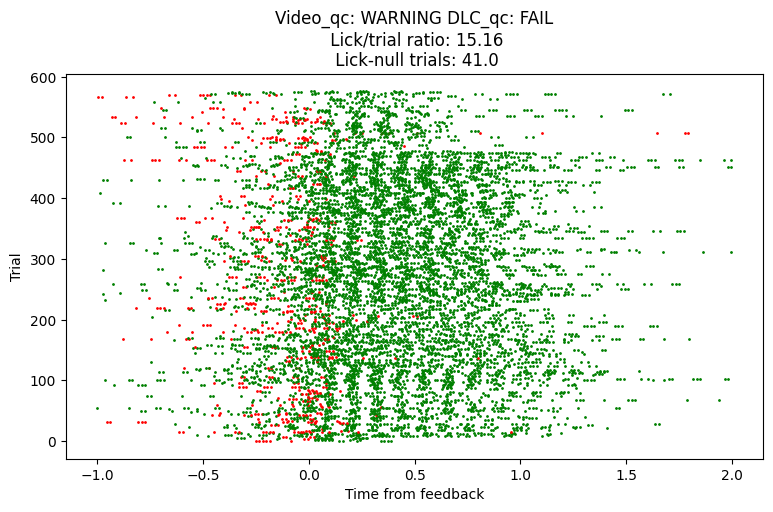

03d9a098-07bf-4765-88b7-85f8d8f620cc


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

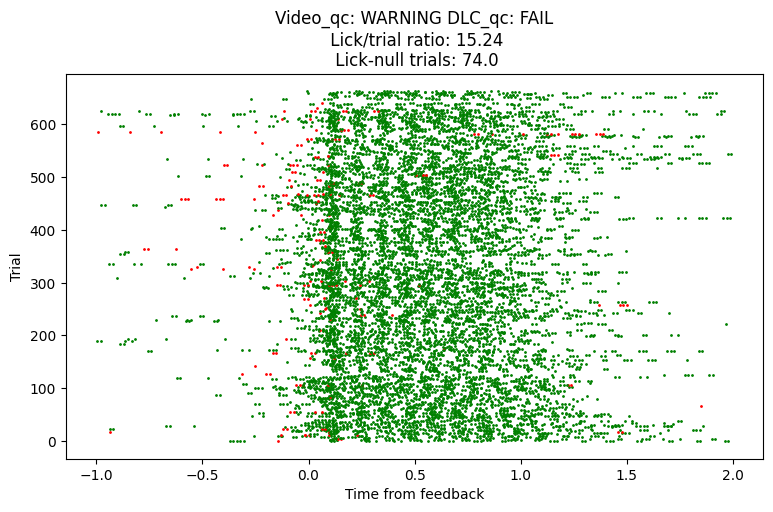

bb099402-fb31-4cfd-824e-1c97530a0875


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

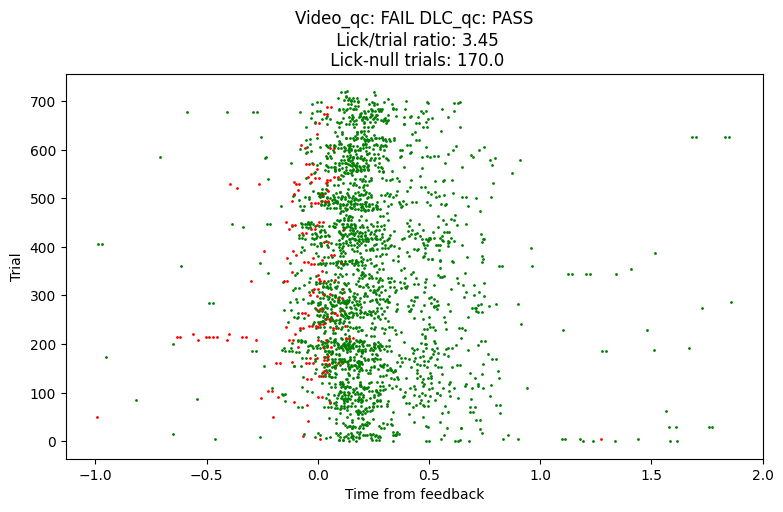

111c1762-7908-47e0-9f40-2f2ee55b6505


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

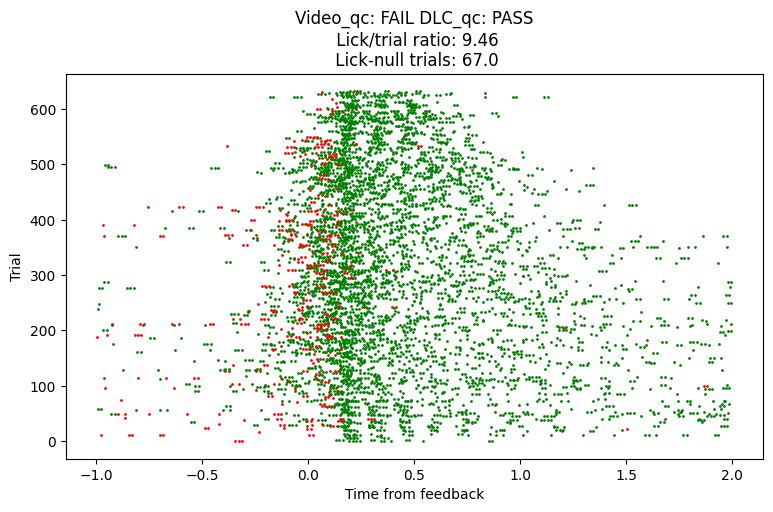

5455a21c-1be7-4cae-ae8e-8853a8d5f55e


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

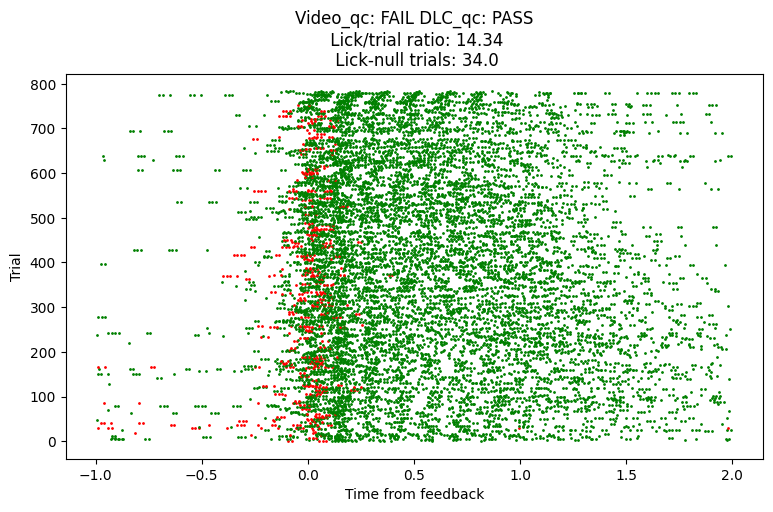

32d27583-56aa-4510-bc03-669036edad20


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

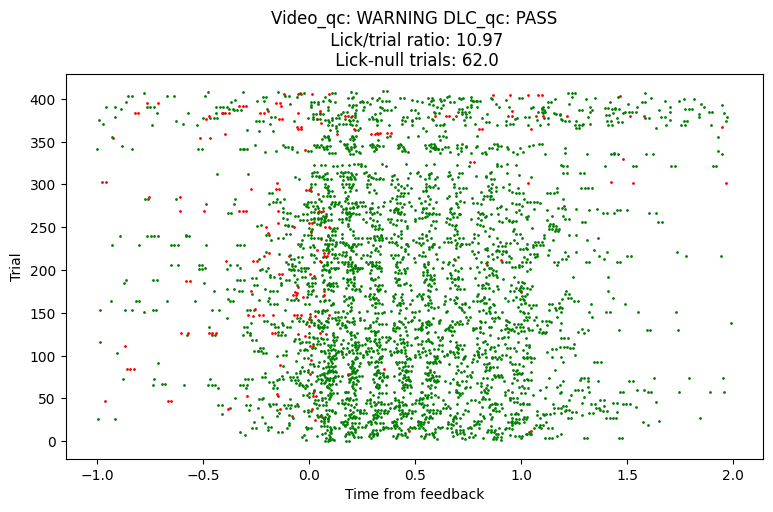

8a3a0197-b40a-449f-be55-c00b23253bbf


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

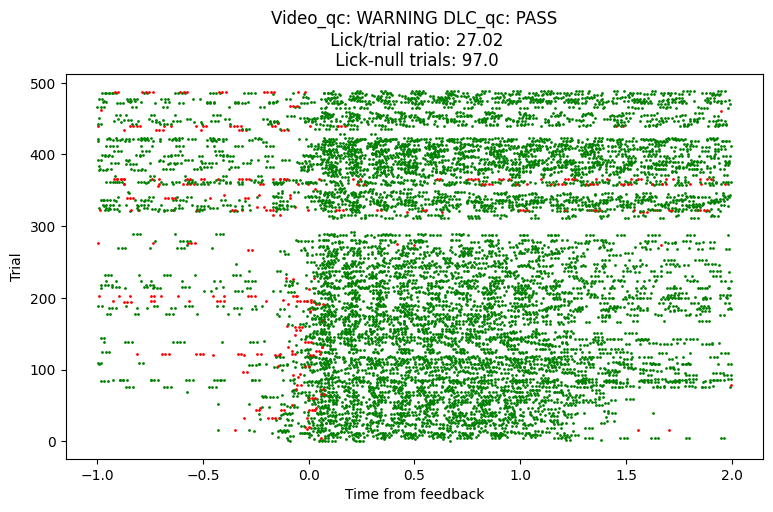

ebc9392c-1ecb-4b4b-a545-4e3d70d23611


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

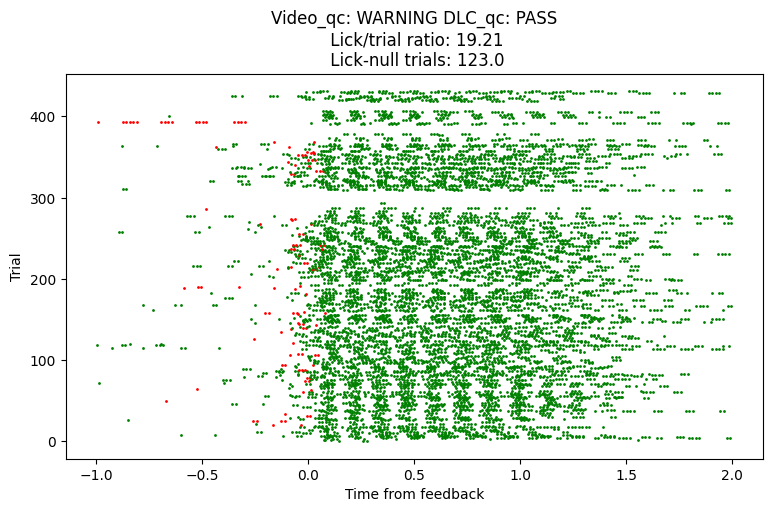

19b44992-d527-4a12-8bda-aa11379cb08c


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

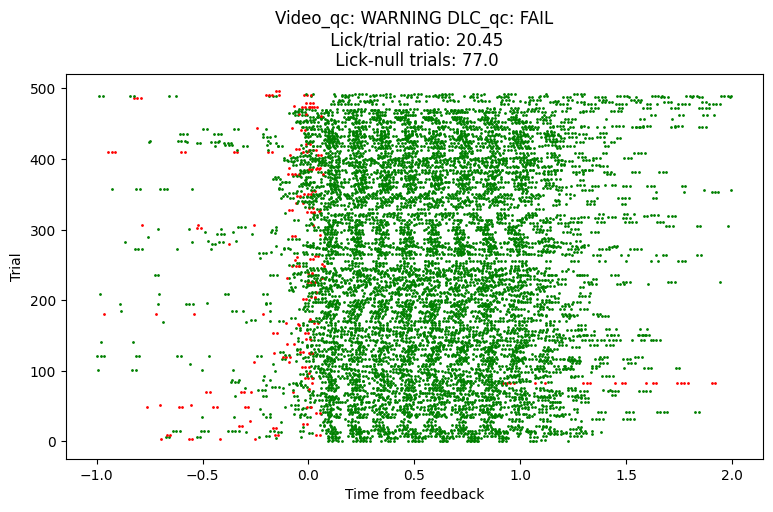

3537d970-f515-4786-853f-23de525e110f


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

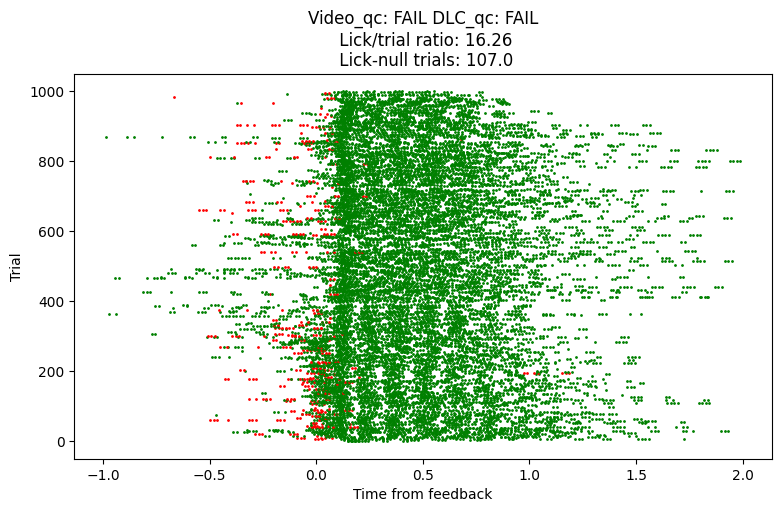

6f36868f-5cc1-450c-82fa-6b9829ce0cfe


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

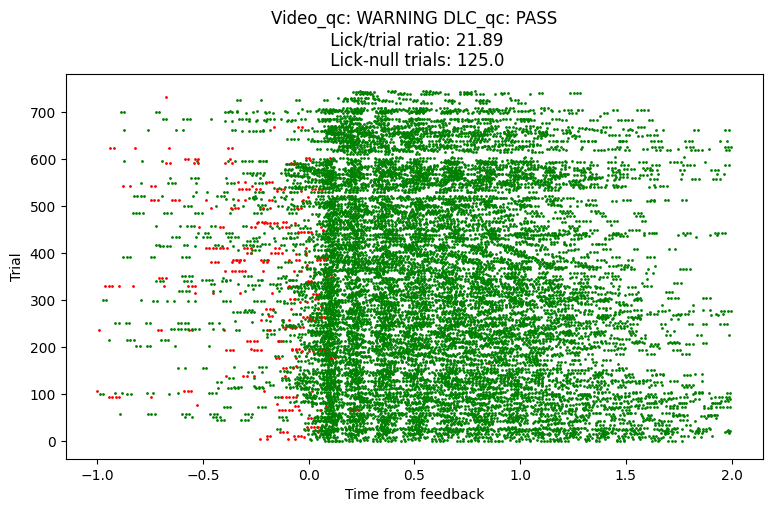

f99ac31f-171b-4208-a55d-5644c0ad51c3


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

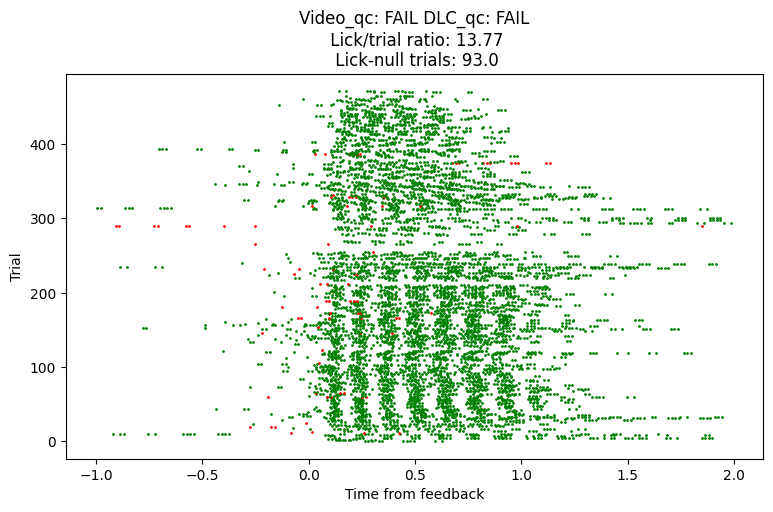

e2b845a1-e313-4a08-bc61-a5f662ed295e


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

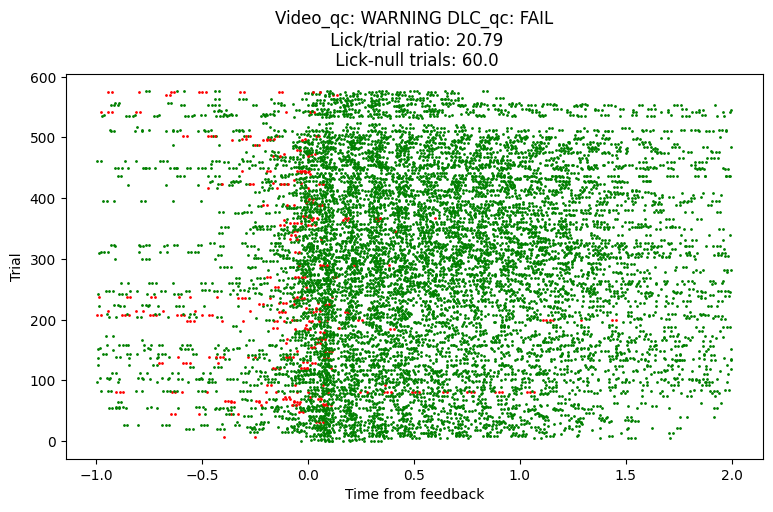

2bdf206a-820f-402f-920a-9e86cd5388a4


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

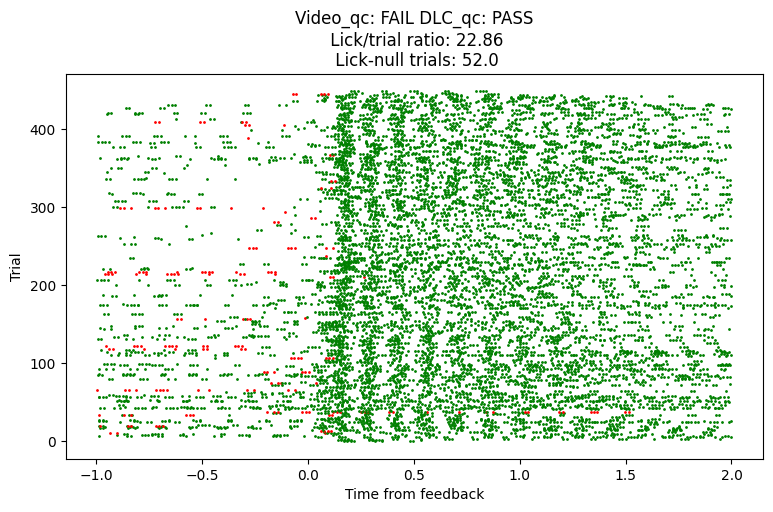

fa8ad50d-76f2-45fa-a52f-08fe3d942345


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

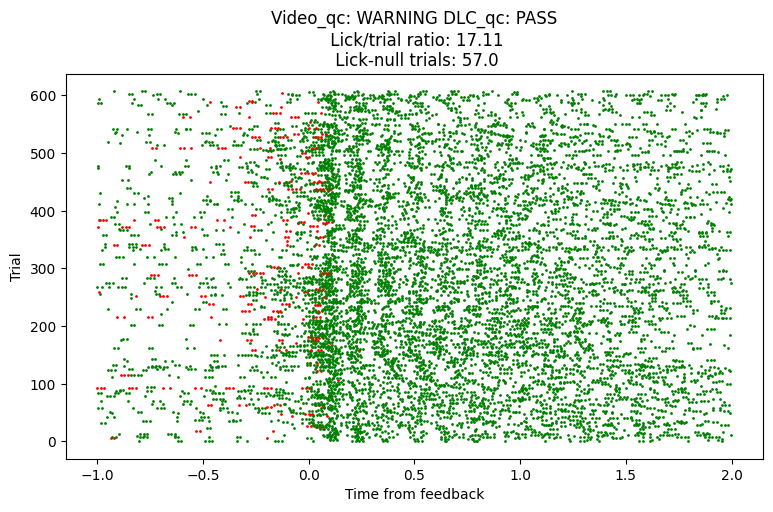

8d316998-28c3-4265-b029-e2ca82375b2f


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

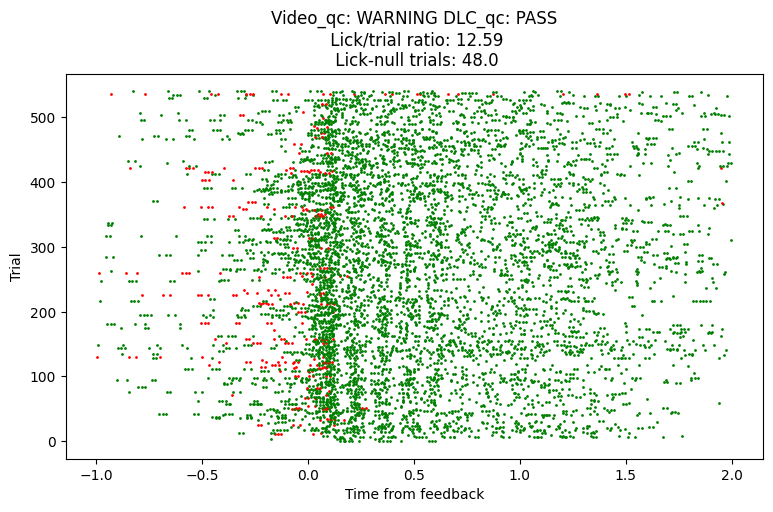

bda2faf5-9563-4940-a80f-ce444259e47b


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

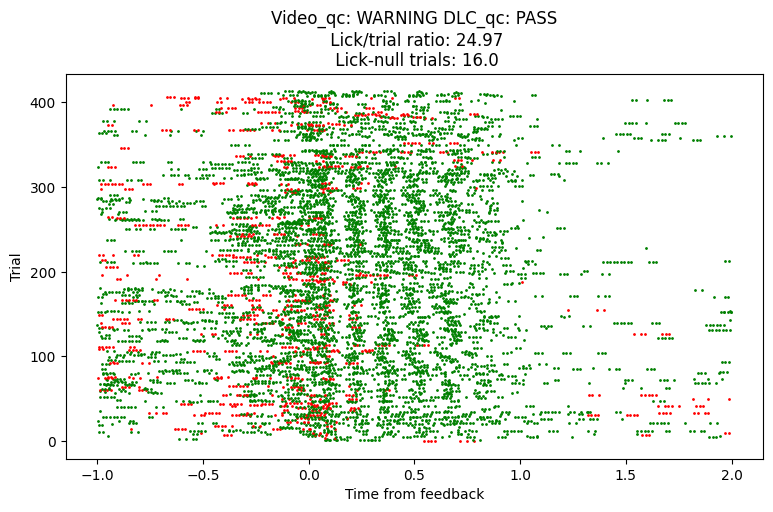

4503697e-af44-47d9-898d-4924be990240


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

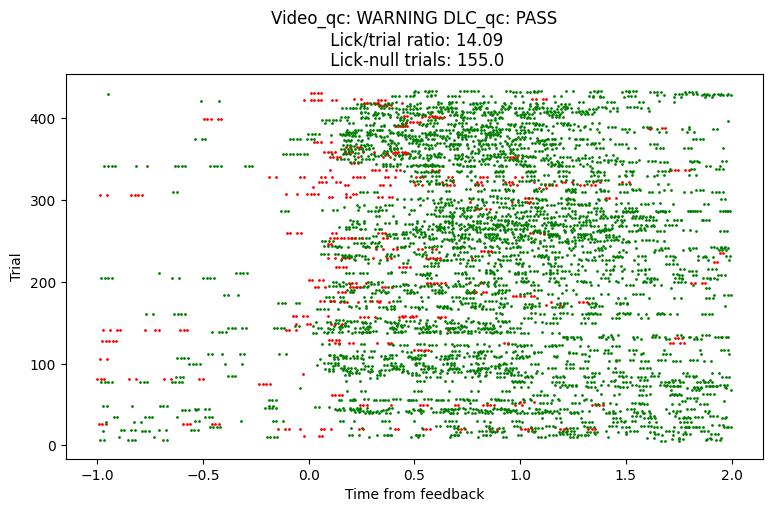

1b715600-0cbc-442c-bd00-5b0ac2865de1


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

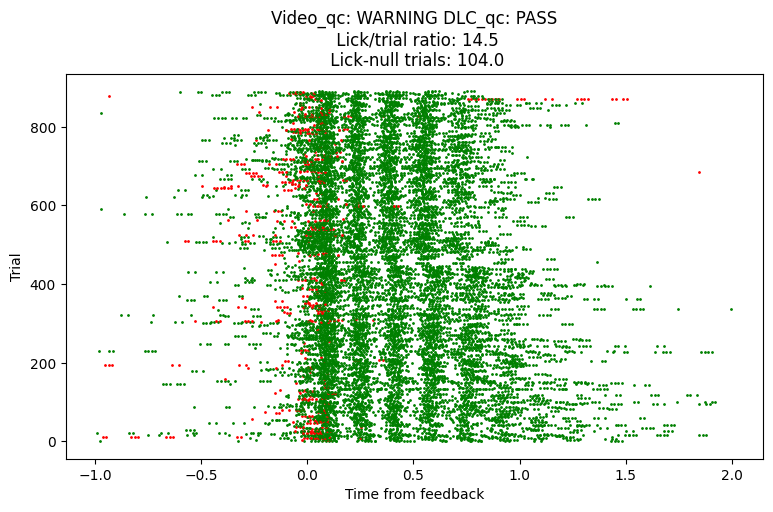

78b4fff5-c5ec-44d9-b5f9-d59493063f00


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

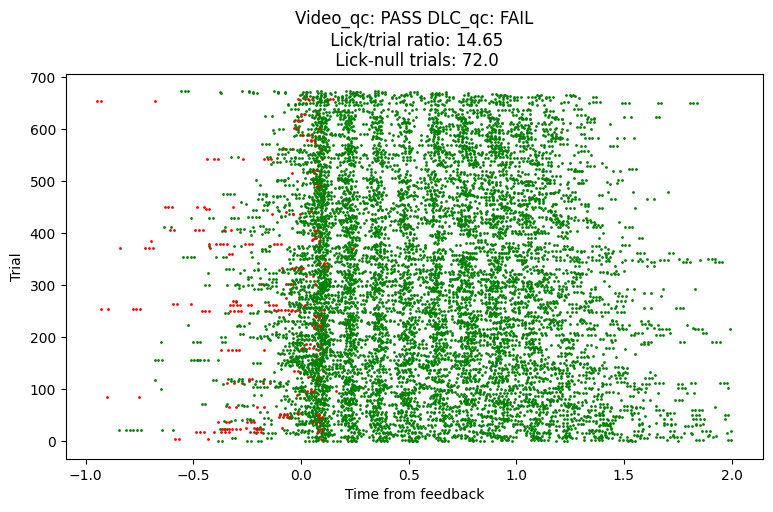

6b0b5d24-bcda-4053-a59c-beaa1fe03b8f


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

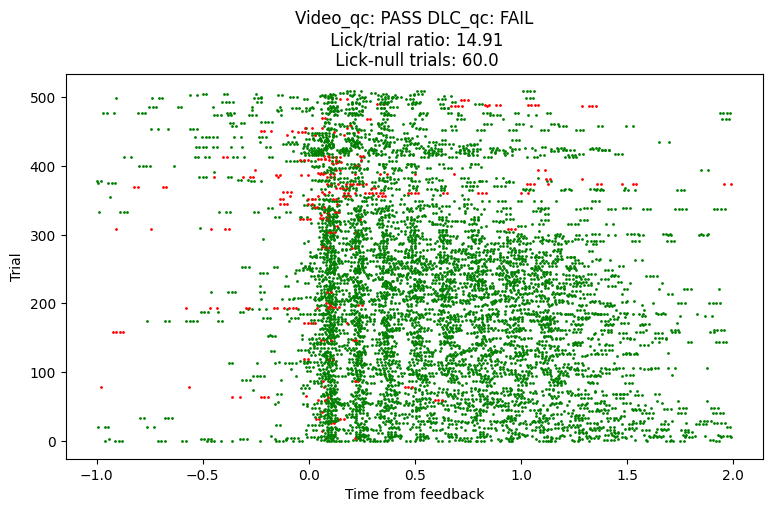

752456f3-9f47-4fbf-bd44-9d131c0f41aa


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

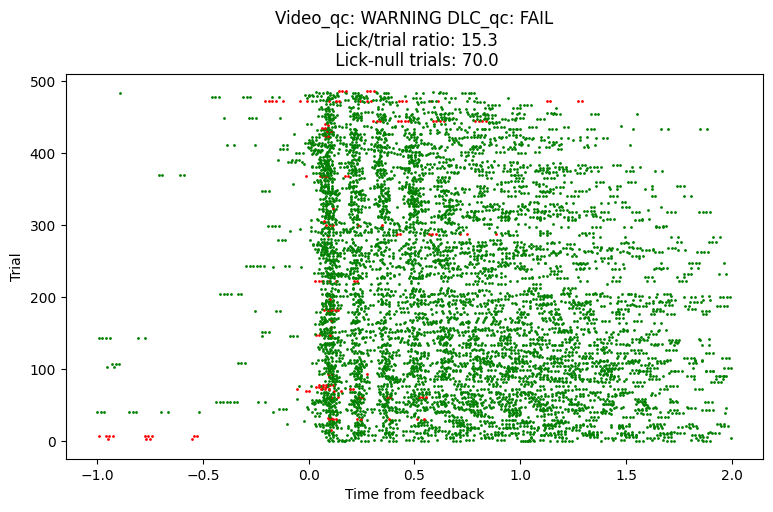

3f859b5c-e73a-4044-b49e-34bb81e96715


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

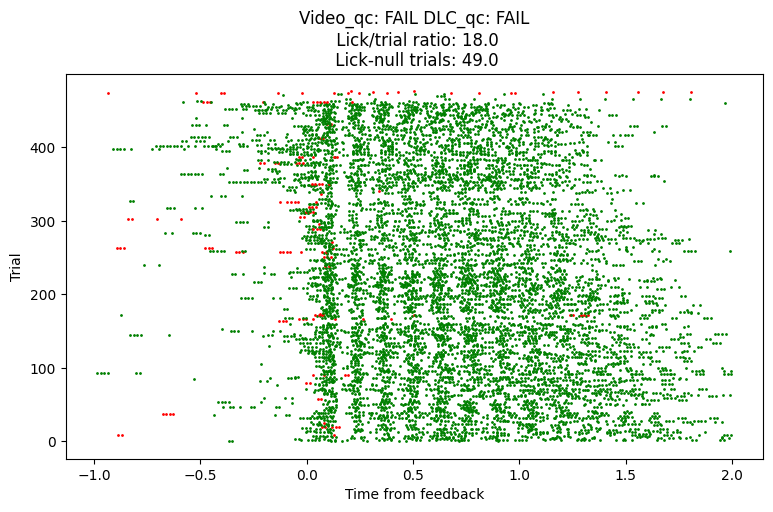

c8d46ee6-eb68-4535-8756-7c9aa32f10e4


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

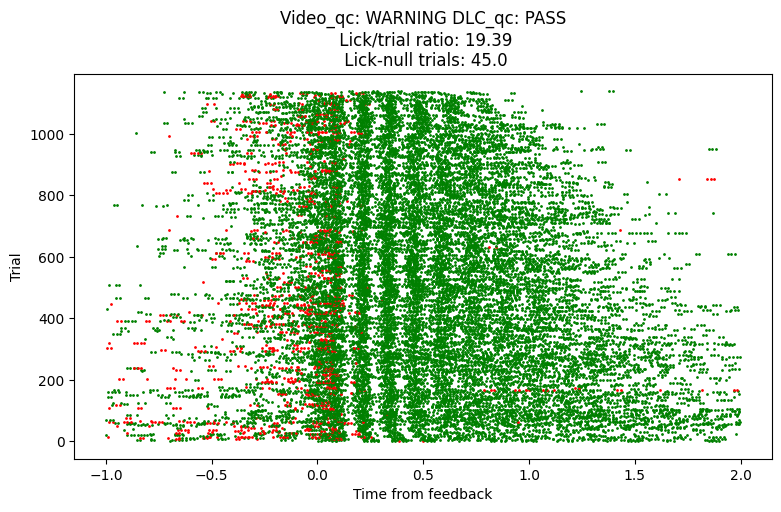

1b9e349e-93f2-41cc-a4b5-b212d7ddc8df


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

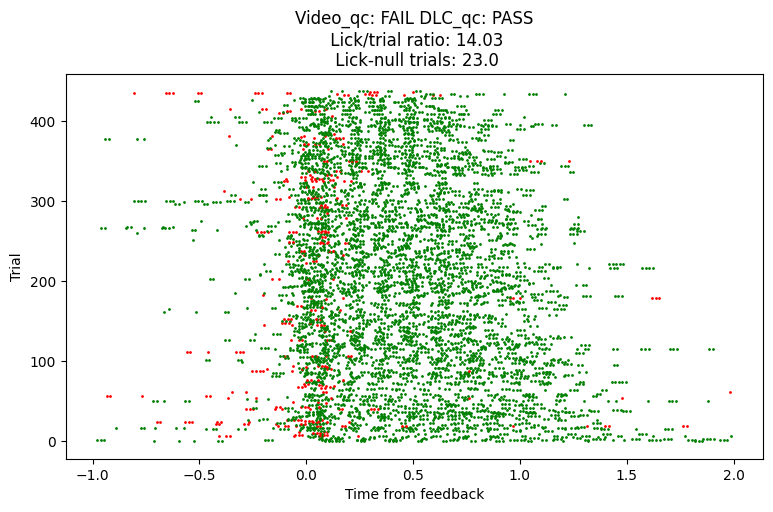

f819d499-8bf7-4da0-a431-15377a8319d5


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

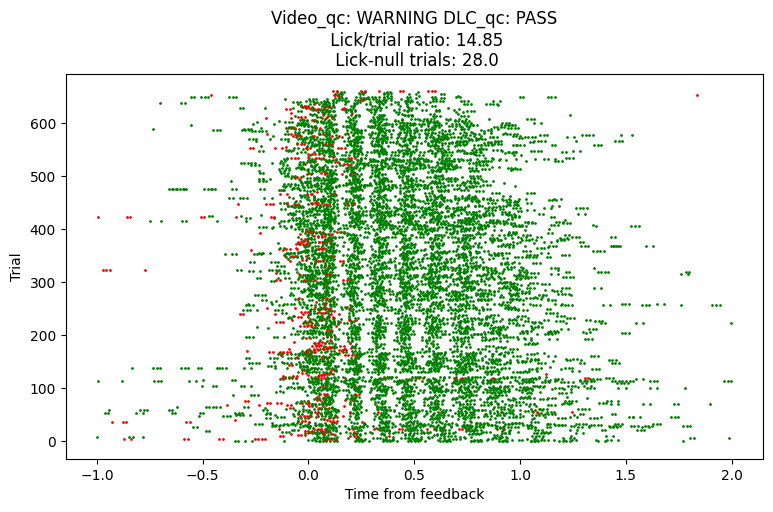

8928f98a-b411-497e-aa4b-aa752434686d


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

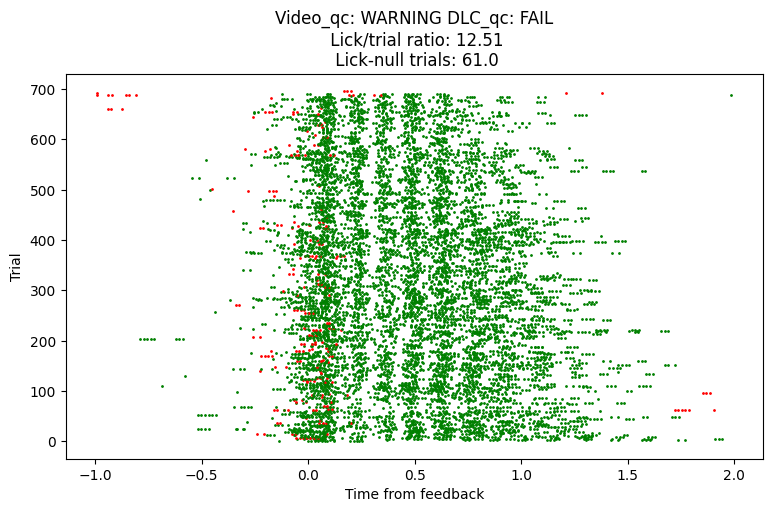

446f4724-1690-49f9-819a-2bd8e2ea88ce


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

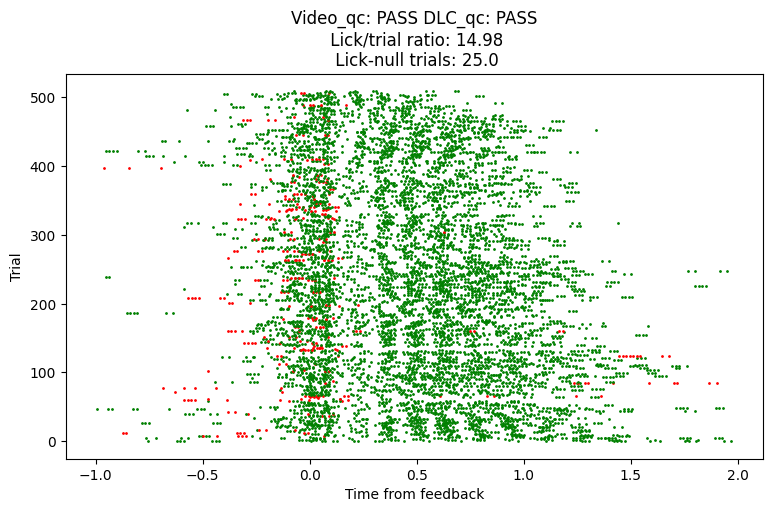

a2701b93-d8e1-47e9-a819-f1063046f3e7


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

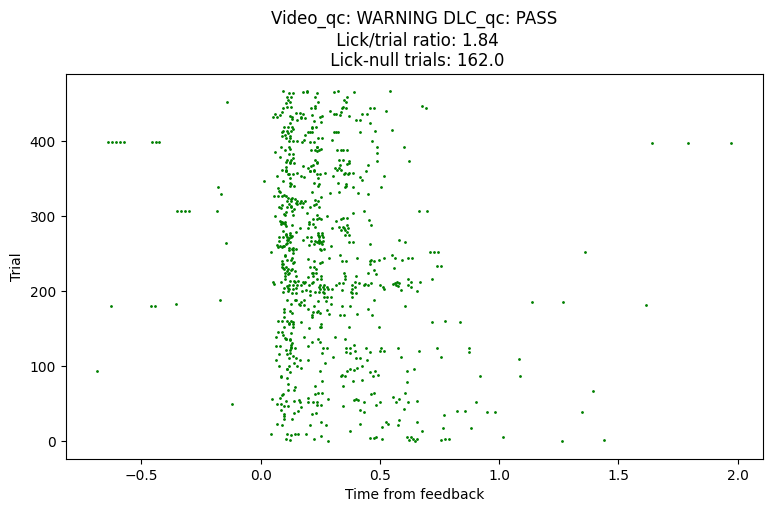

0f25376f-2b78-4ddc-8c39-b6cdbe7bf5b9


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

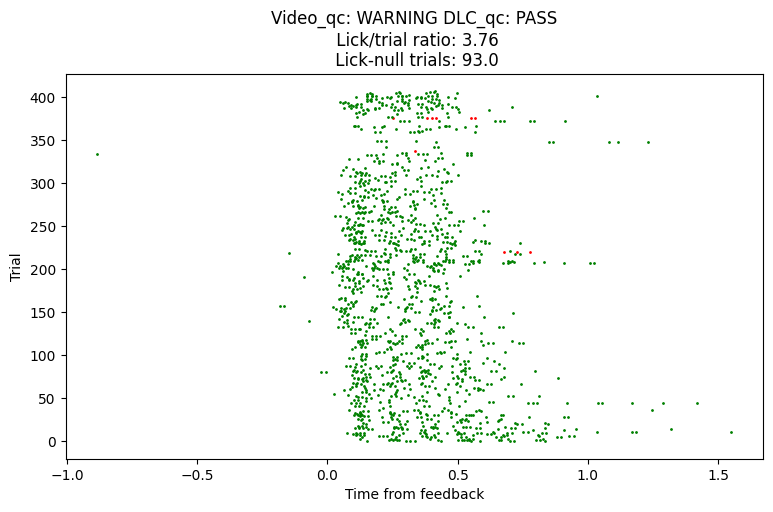

ee13c19e-2790-4418-97ca-48f02e8013bb


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

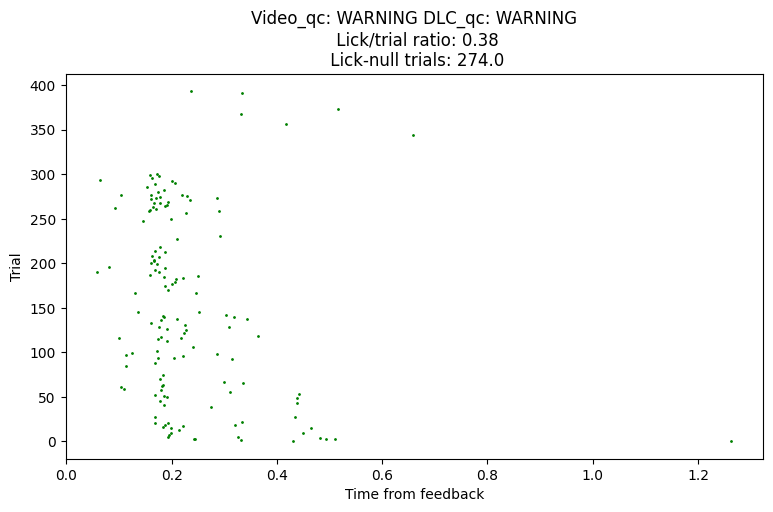

db4df448-e449-4a6f-a0e7-288711e7a75a


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

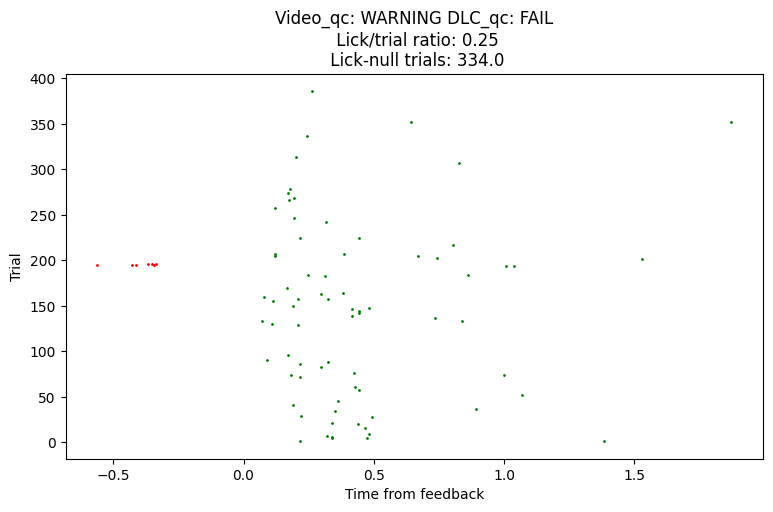

3dd347df-f14e-40d5-9ff2-9c49f84d2157


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

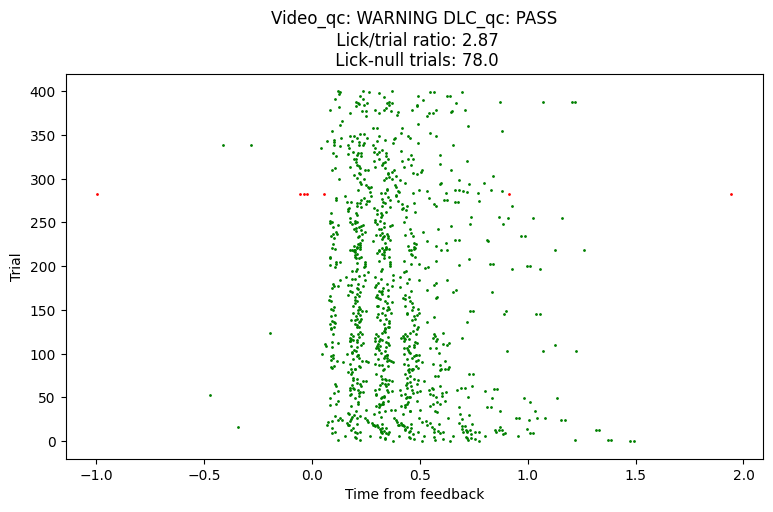

3c851386-e92d-4533-8d55-89a46f0e7384


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

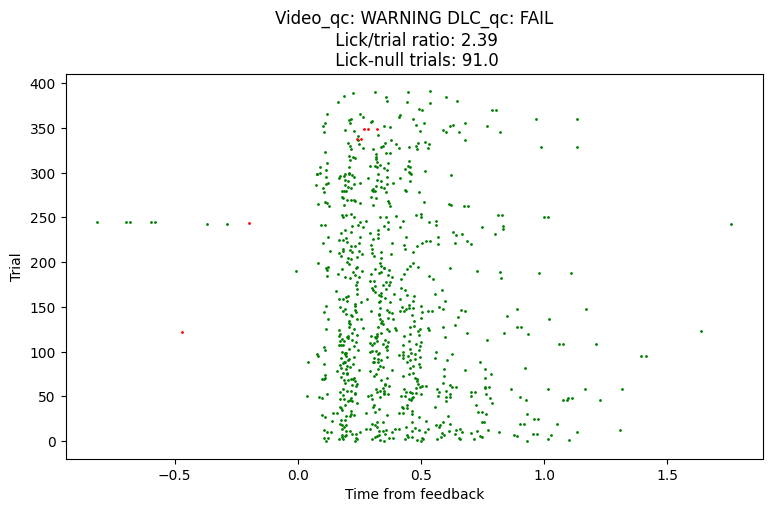

158d5d35-a2ab-4a76-87b0-51048c5d5283


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

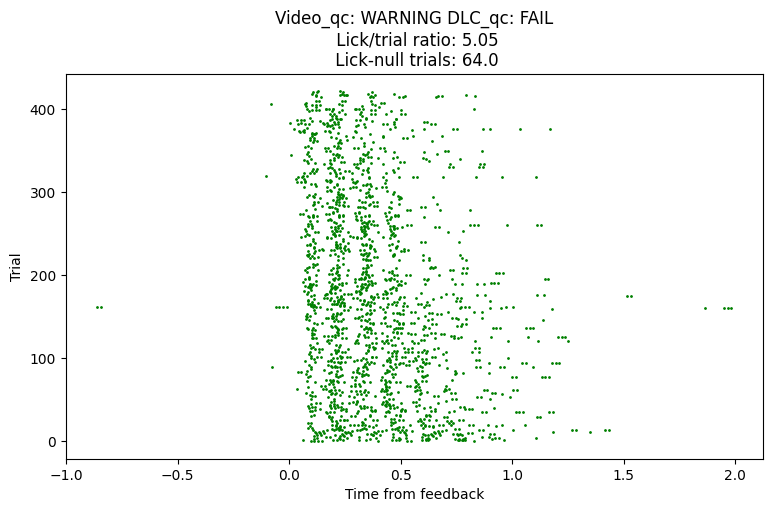

30e5937e-e86a-47e6-93ae-d2ae3877ff8e


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

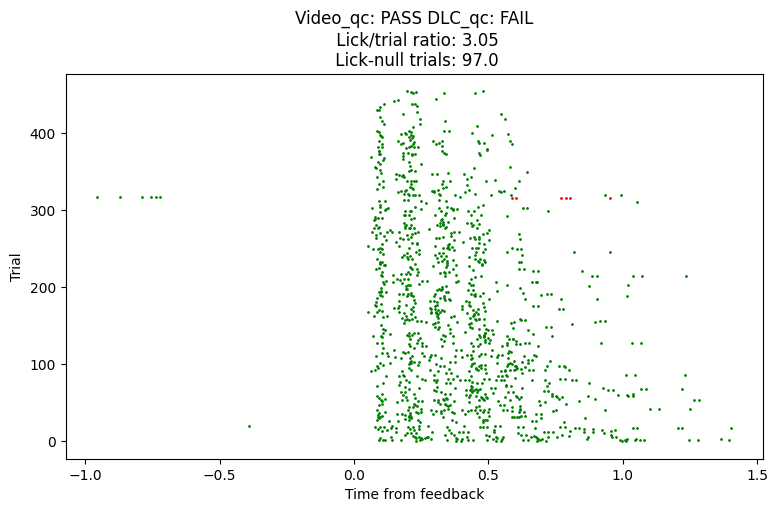

413a6825-2144-4a50-b3fc-cf38ddd6fd1a


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

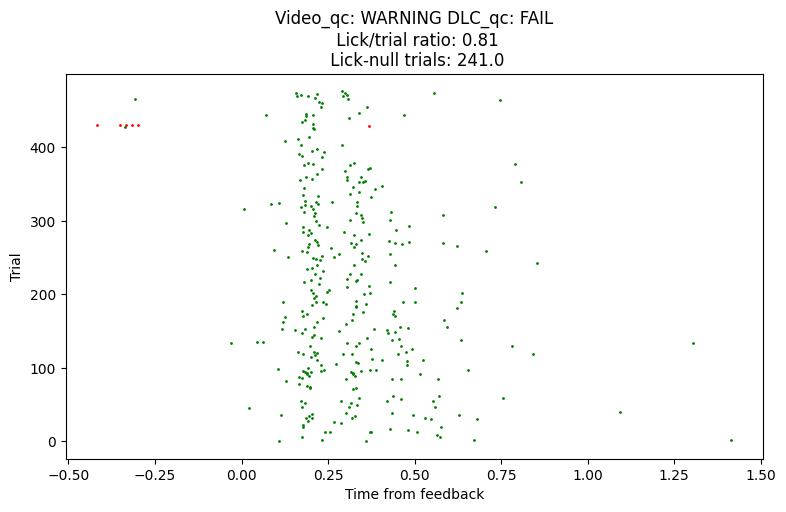

a19c7a3a-7261-42ce-95d5-1f4ca46007ed


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

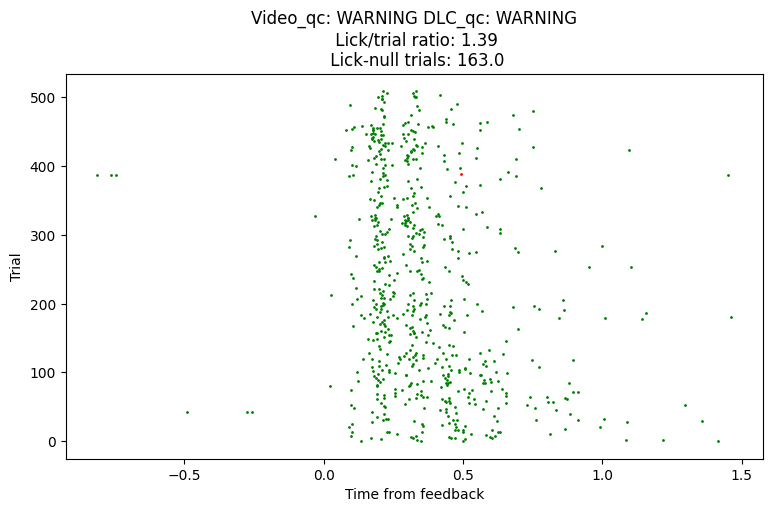

e5c772cd-9c92-47ab-9525-d618b66a9b5d


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

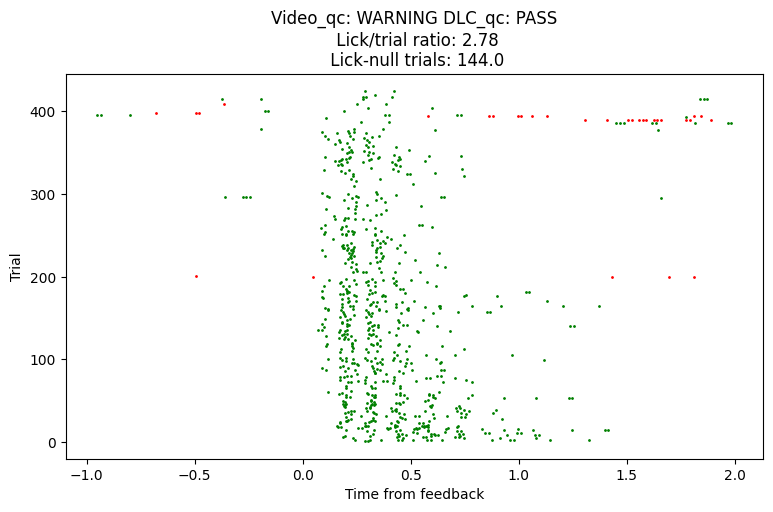

6668c4a0-70a4-4012-a7da-709660971d7a


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

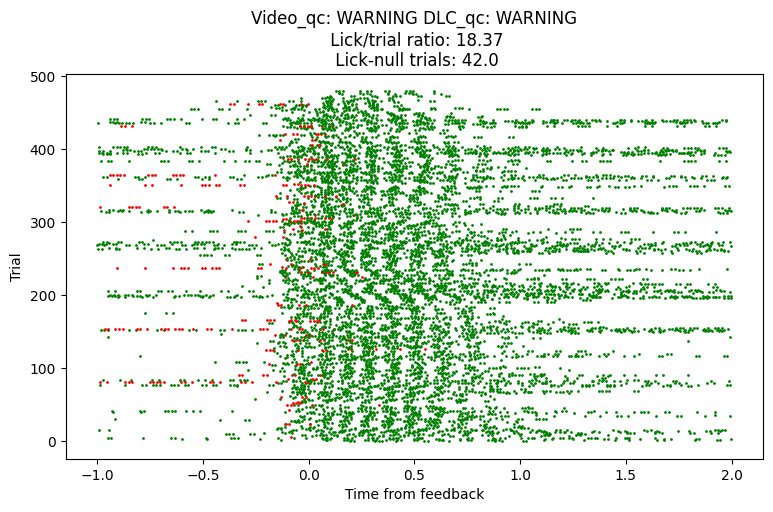

4fa70097-8101-4f10-b585-db39429c5ed0


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

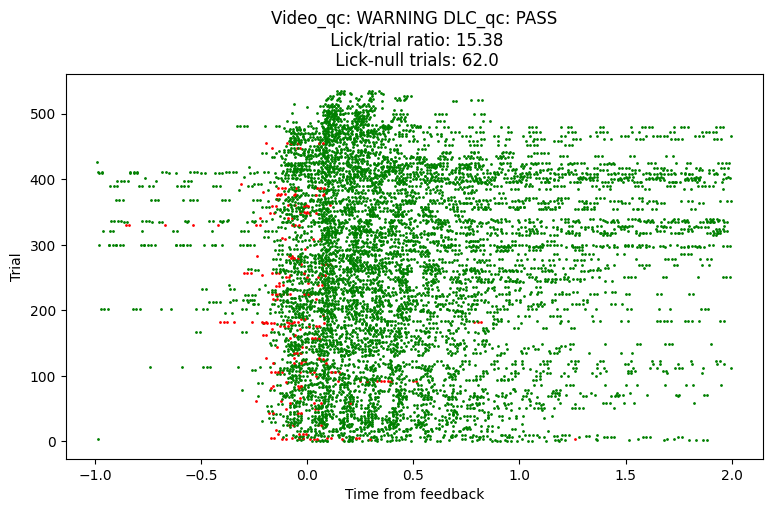

90d1e82c-c96f-496c-ad4e-ee3f02067f25


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

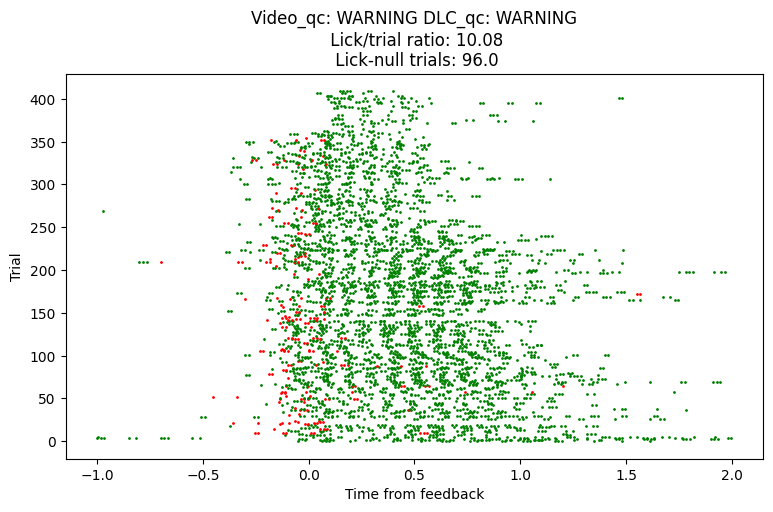

bb6a5aae-2431-401d-8f6a-9fdd6de655a9


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

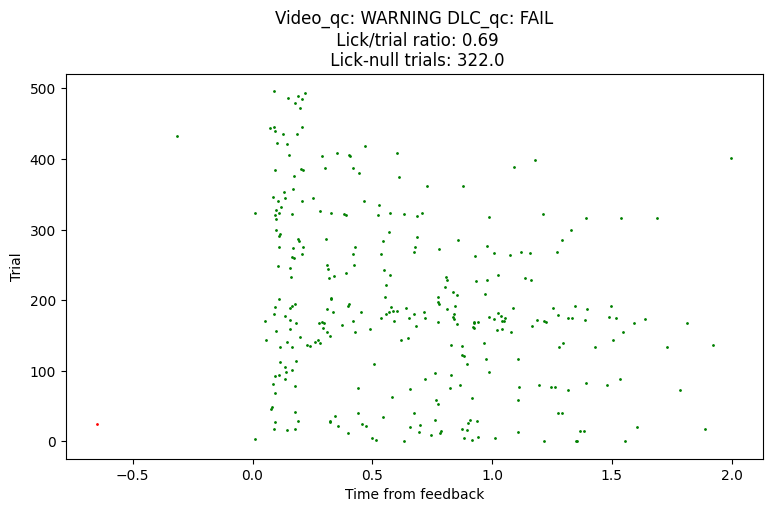

931a70ae-90ee-448e-bedb-9d41f3eda647


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

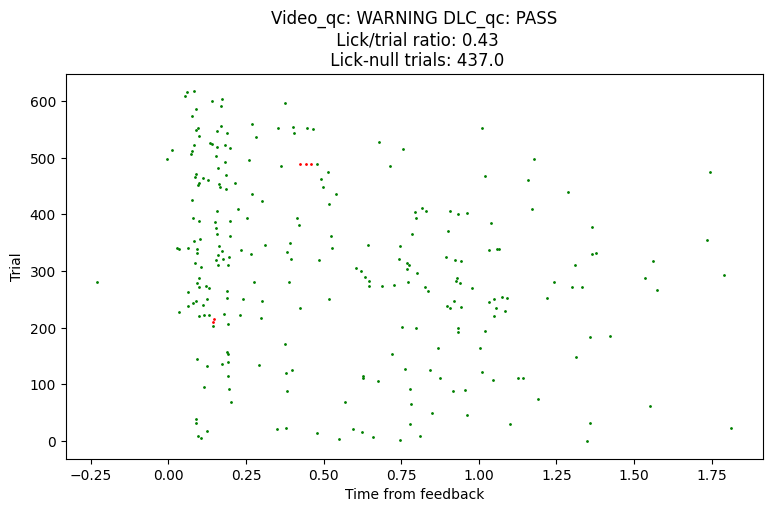

02fbb6da-3034-47d6-a61b-7d06c796a830


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

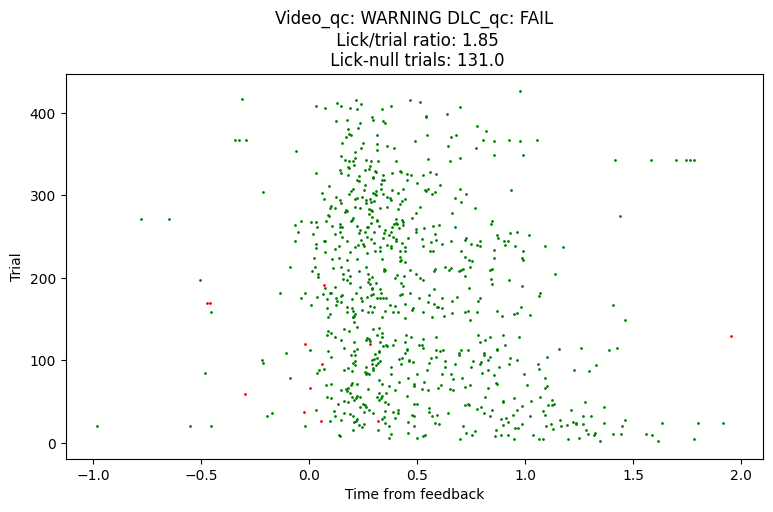

7bee9f09-a238-42cf-b499-f51f765c6ded


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

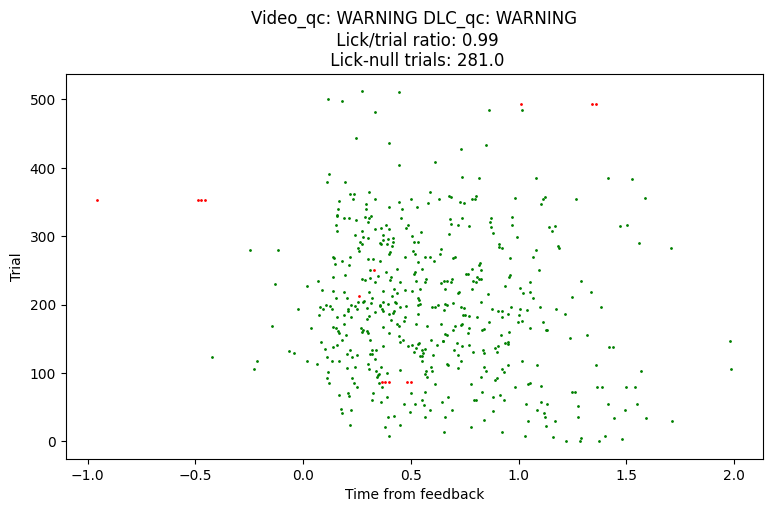

36280321-555b-446d-9b7d-c2e17991e090


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

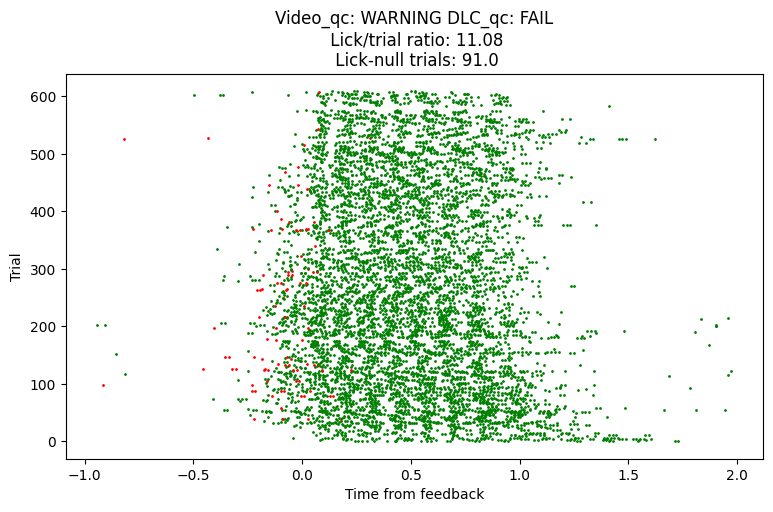

741979ce-3f10-443a-8526-2275620c8473


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

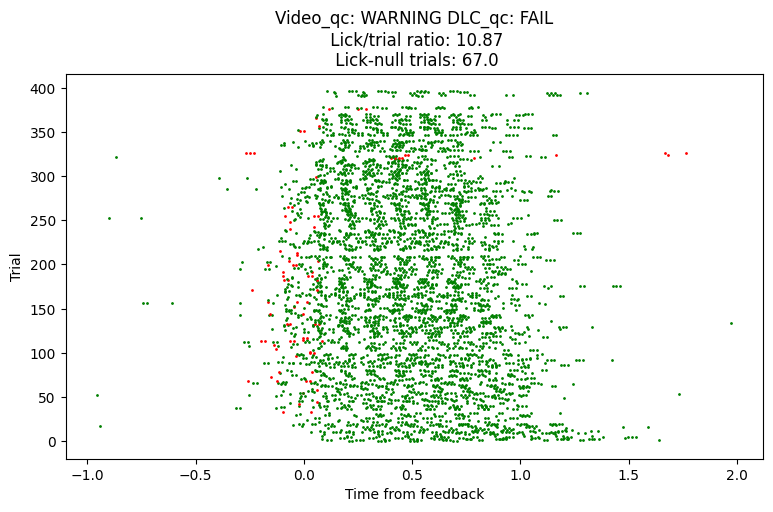

cf43dbb1-6992-40ec-a5f9-e8e838d0f643


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

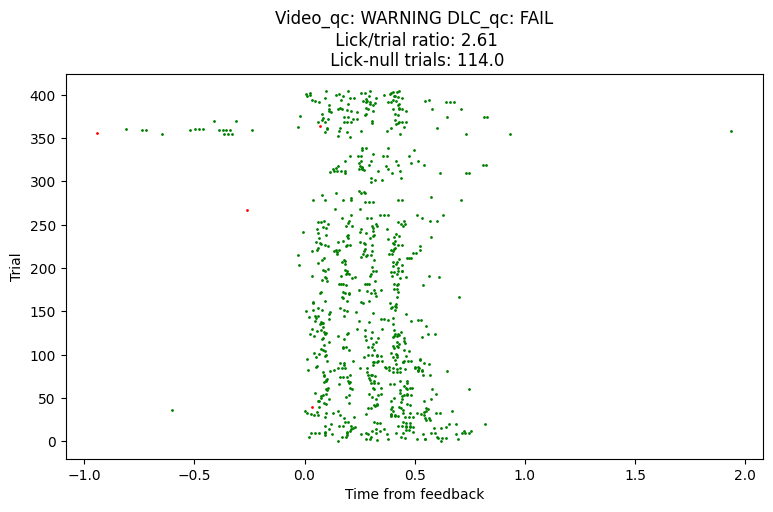

2f63c555-eb74-4d8d-ada5-5c3ecf3b46be


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

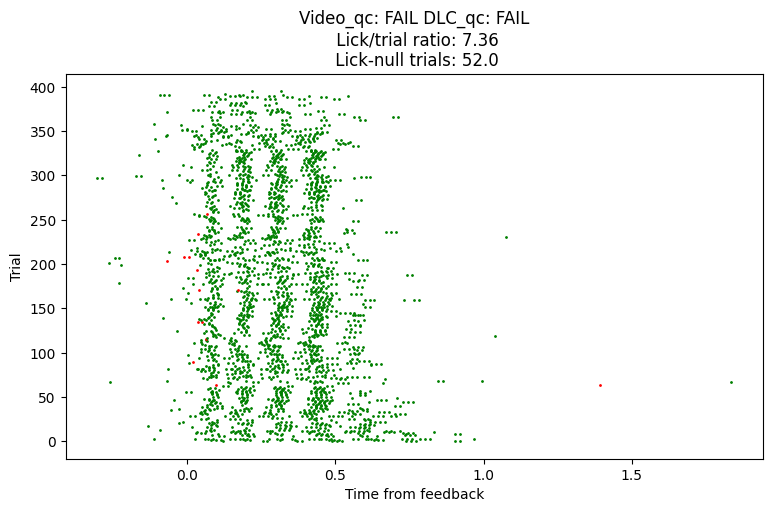

9a629642-3a9c-42ed-b70a-532db0e86199


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

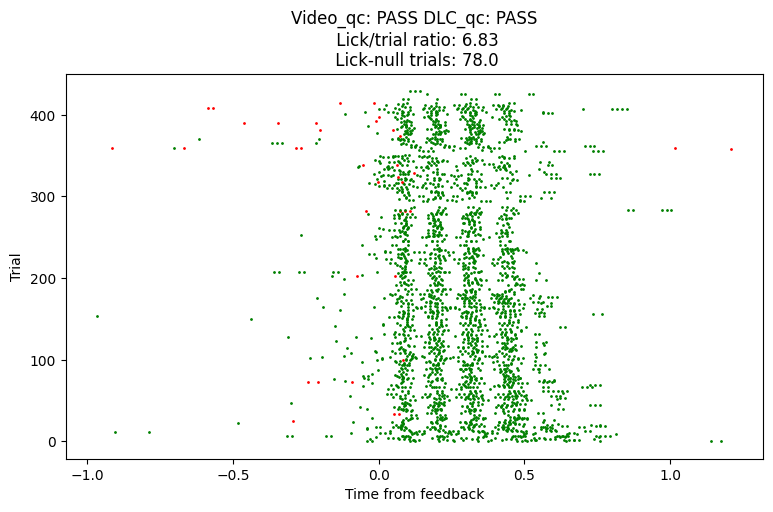

e535fb62-e245-4a48-b119-88ce62a6fe67


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

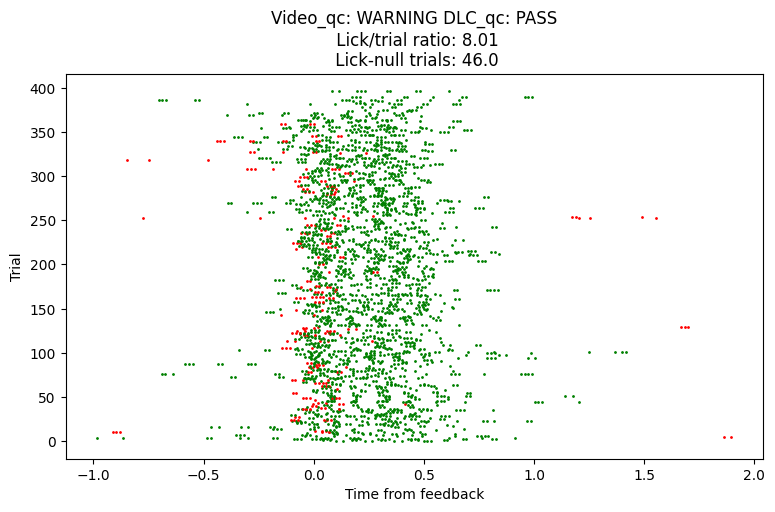

f25642c6-27a5-4a97-9ea0-06652db79fbd


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

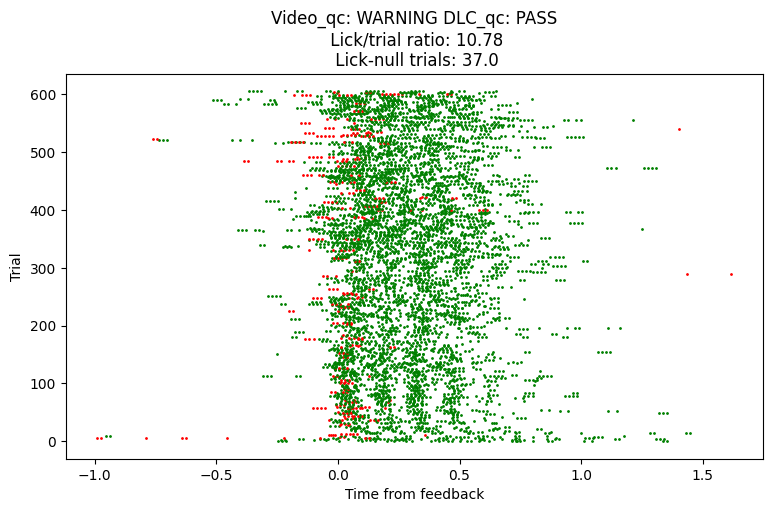

4720c98a-a305-4fba-affb-bbfa00a724a4


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

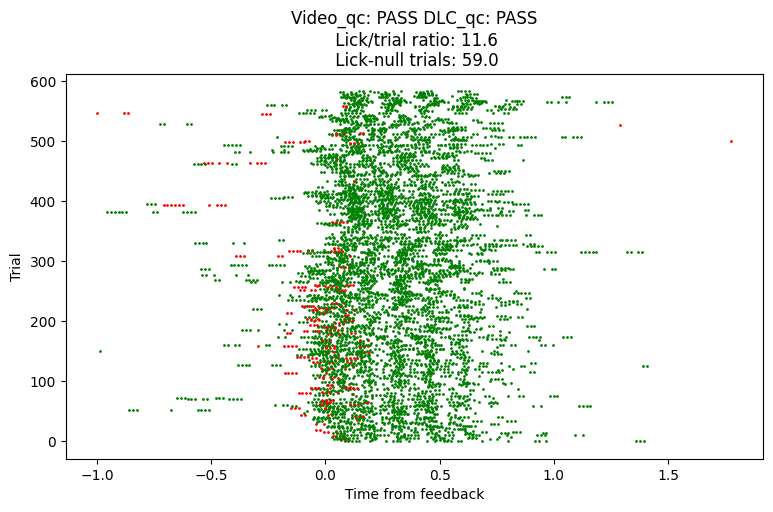

7622da34-51b6-4661-98ae-a57d40806008


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

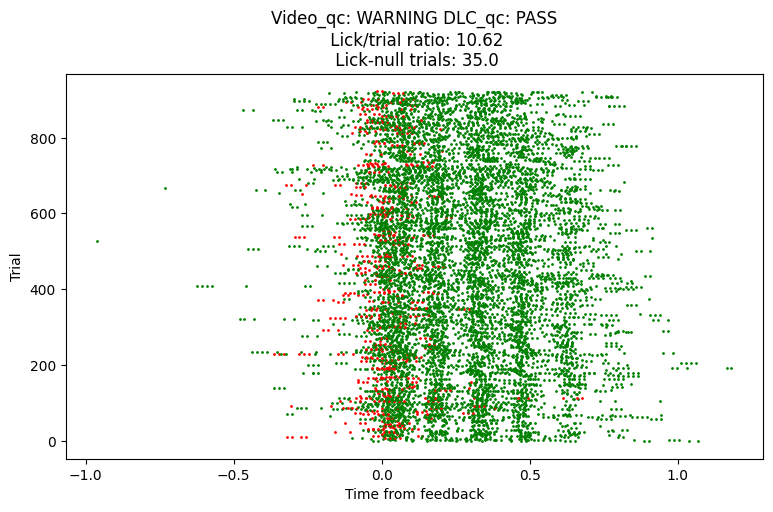

b658bc7d-07cd-4203-8a25-7b16b549851b


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

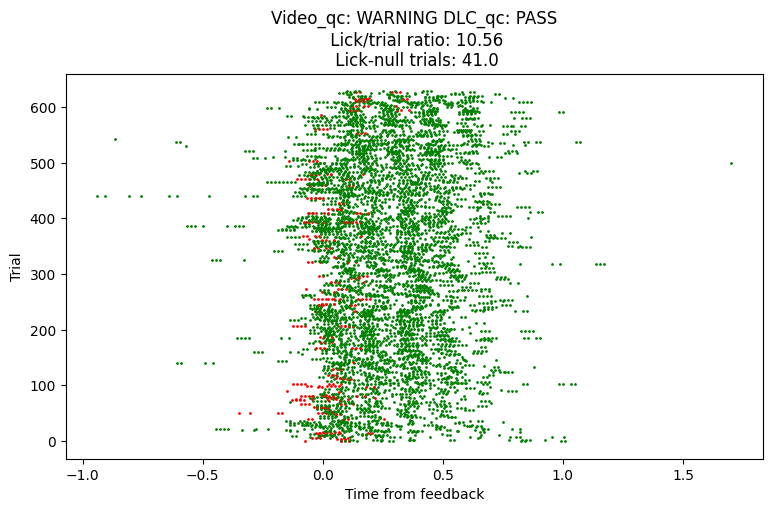

bd456d8f-d36e-434a-8051-ff3997253802


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

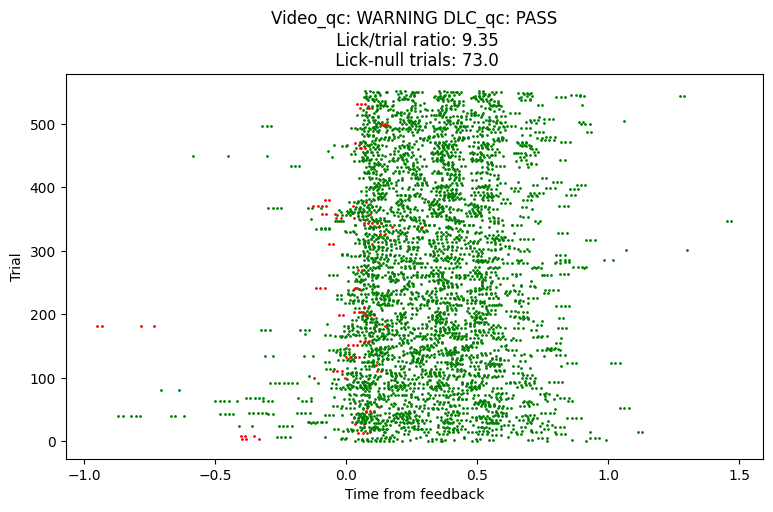

ee8b36de-779f-4dea-901f-e0141c95722b


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

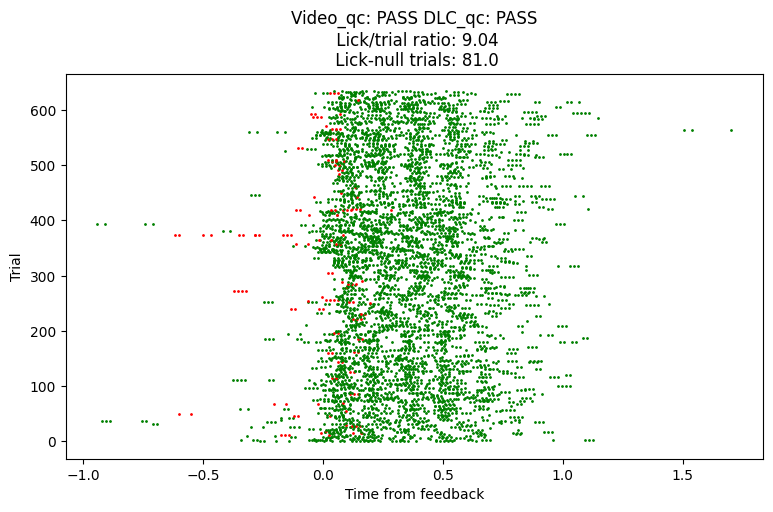

b39752db-abdb-47ab-ae78-e8608bbf50ed


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

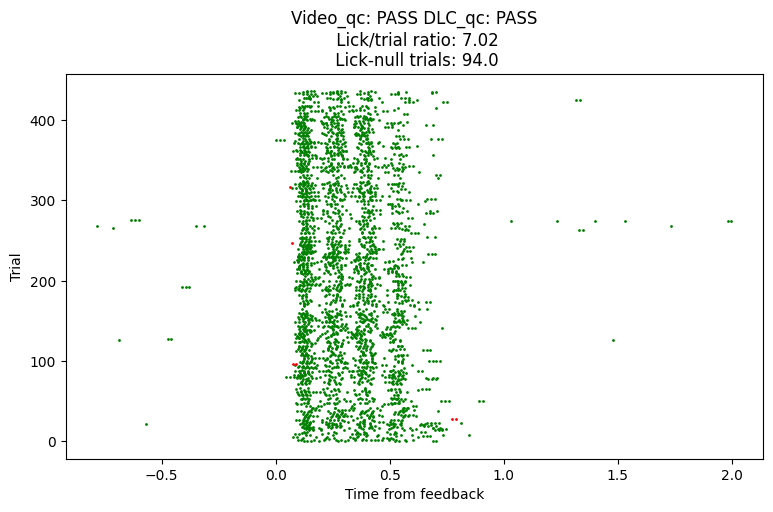

5339812f-8b91-40ba-9d8f-a559563cc46b


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

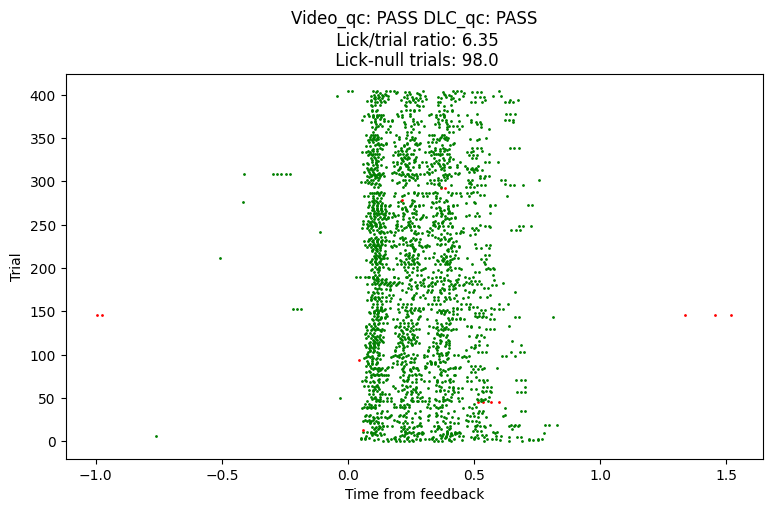

d23a44ef-1402-4ed7-97f5-47e9a7a504d9


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

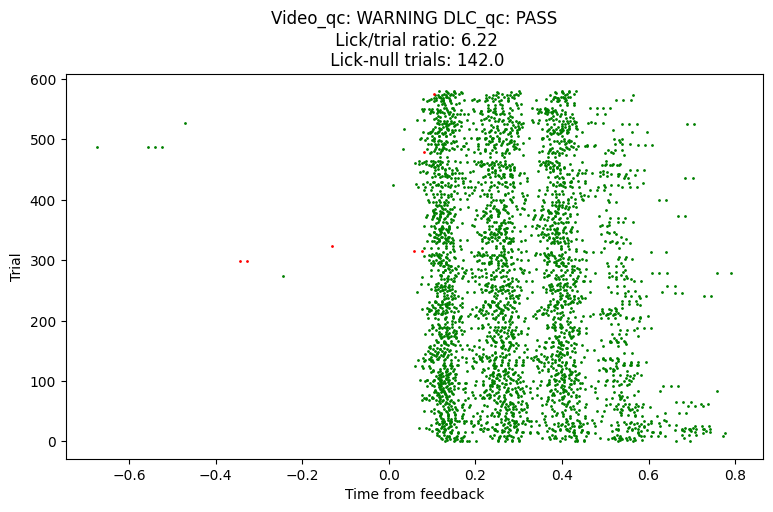

c3d9b6fb-7fa9-4413-a364-92a54df0fc5d


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

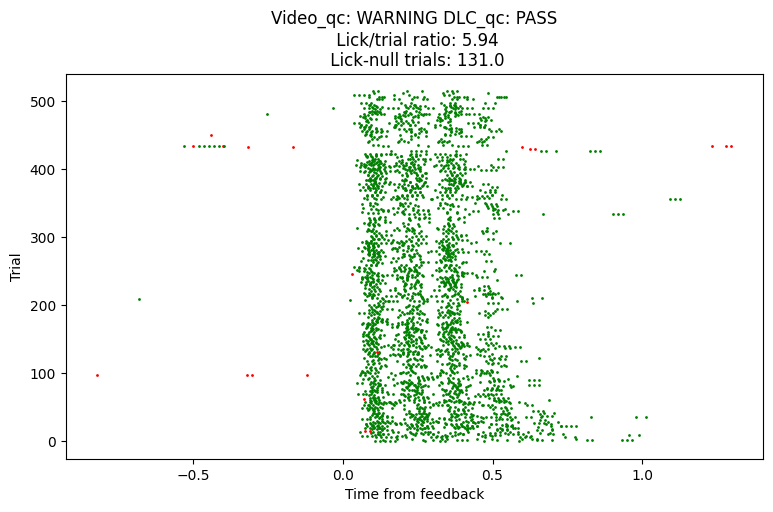

aa20388b-9ea3-4506-92f1-3c2be84b85db


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

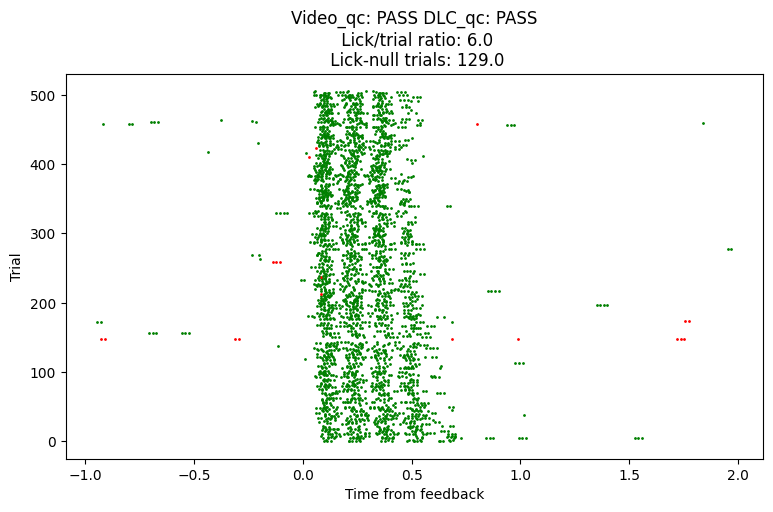

251ece37-7798-477c-8a06-2845d4aa270c


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

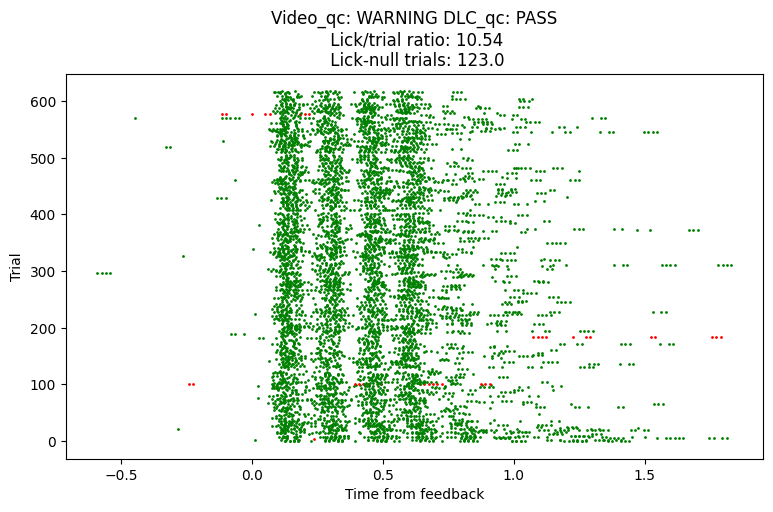

54238fd6-d2d0-4408-b1a9-d19d24fd29ce


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

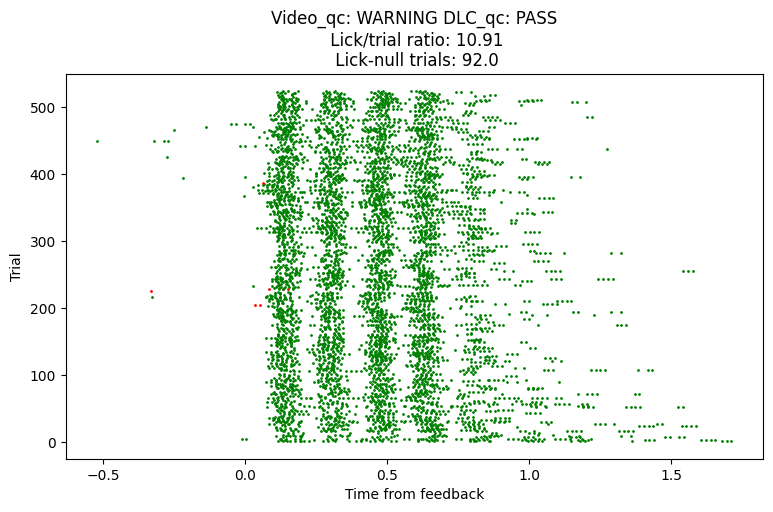

e8b4fda3-7fe4-4706-8ec2-91036cfee6bd


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

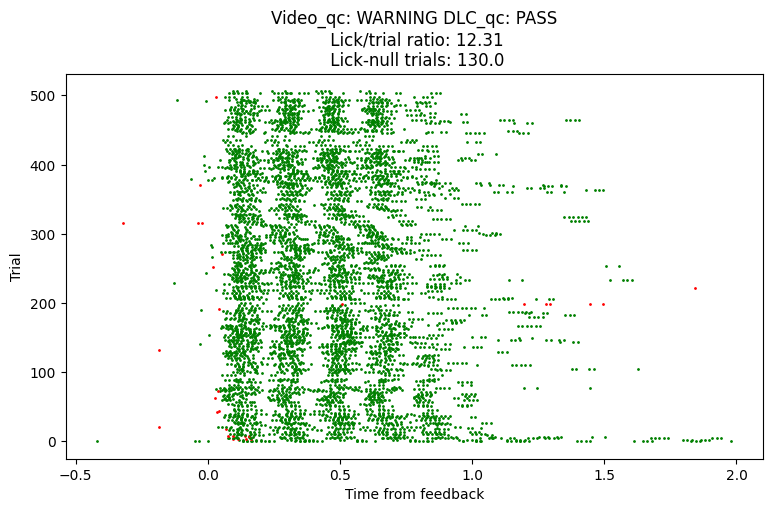

cde63527-7f5a-4cc3-8ac2-215d82e7da26


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

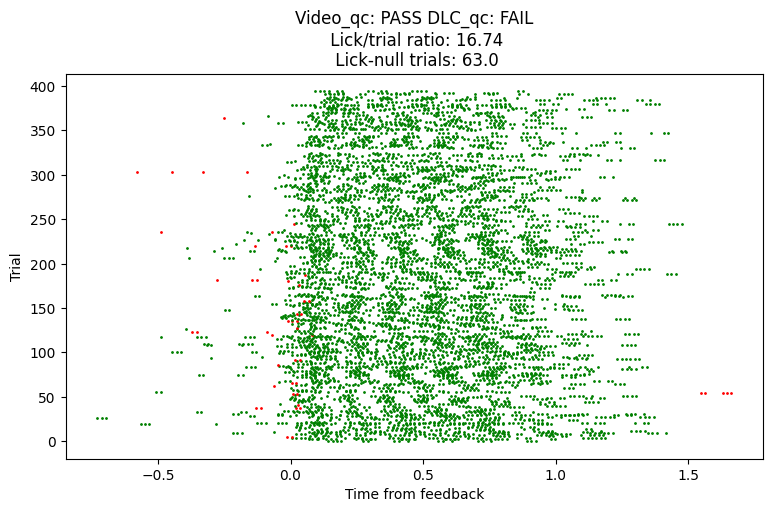

4a45c8ba-db6f-4f11-9403-56e06a33dfa4


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

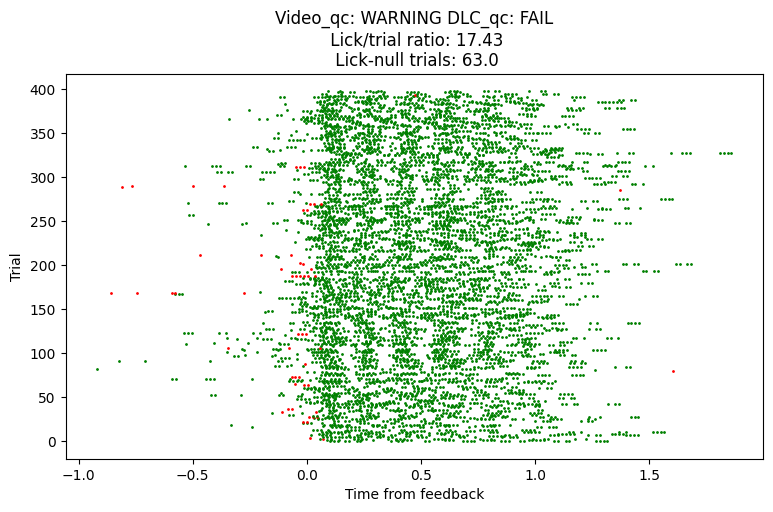

f7335a49-4a98-46d2-a8ce-d041d2eac1d6


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

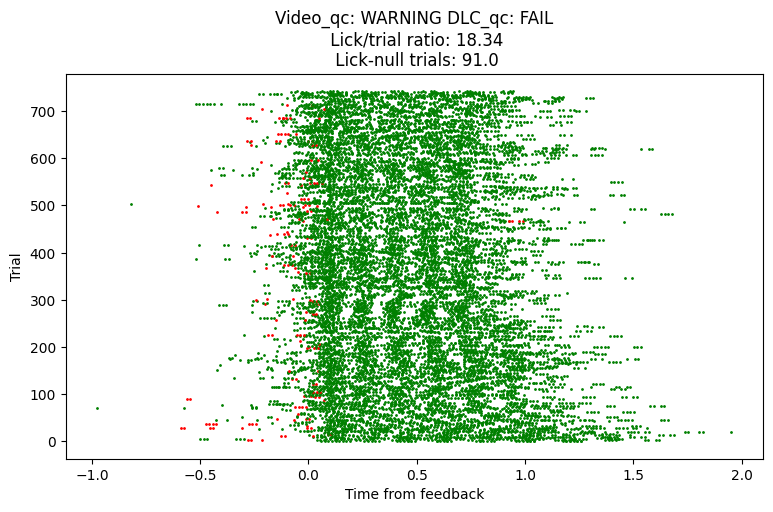

9eec761e-9762-4897-b308-a3a08c311e69


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

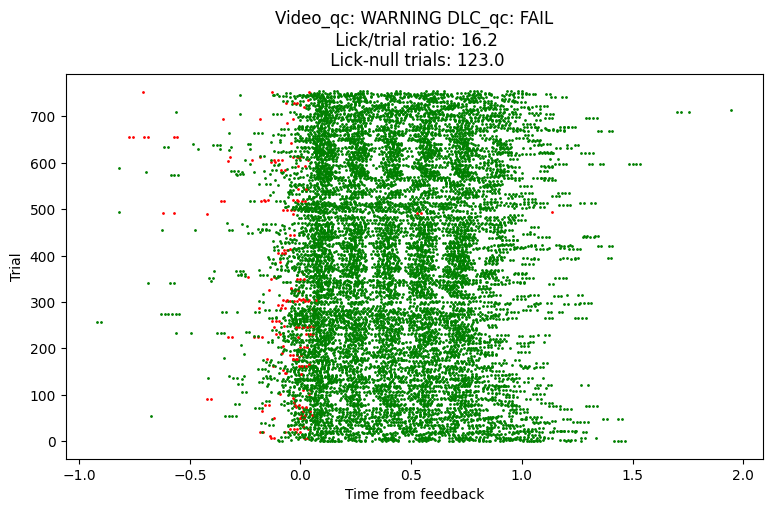

9fe512b8-92a8-4642-83b6-01158ab66c3c


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

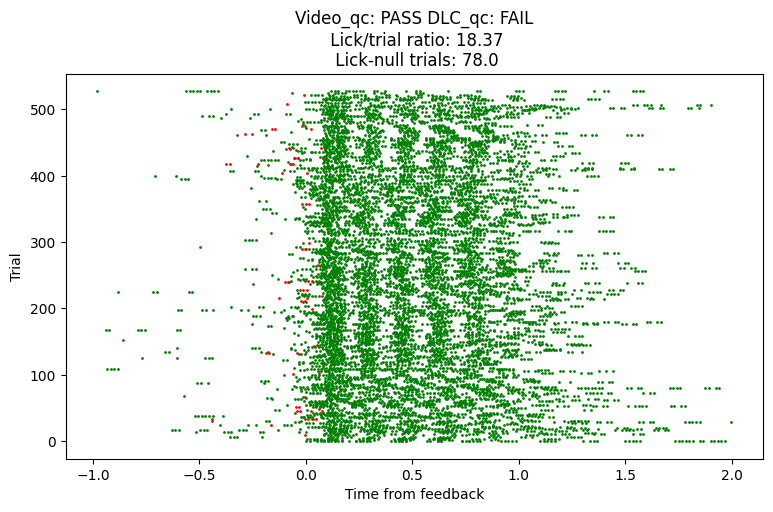

26aa51ff-968c-42e4-85c8-8ff47d19254d


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

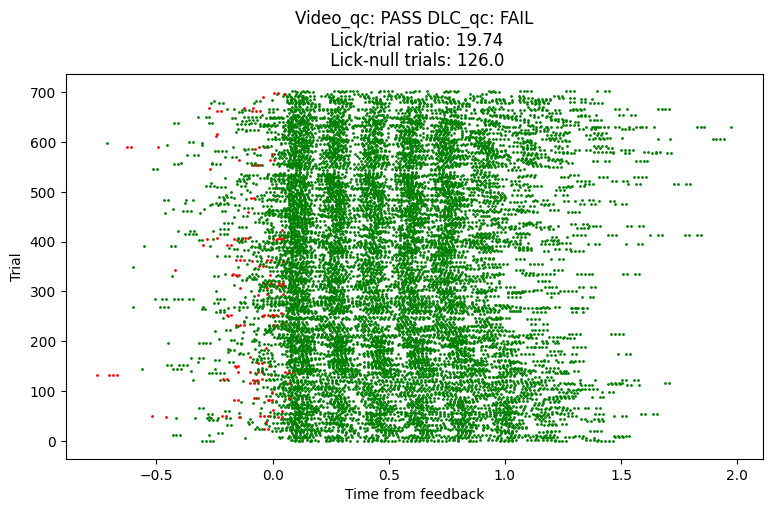

e012d3e3-fdbc-4661-9ffa-5fa284e4e706


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

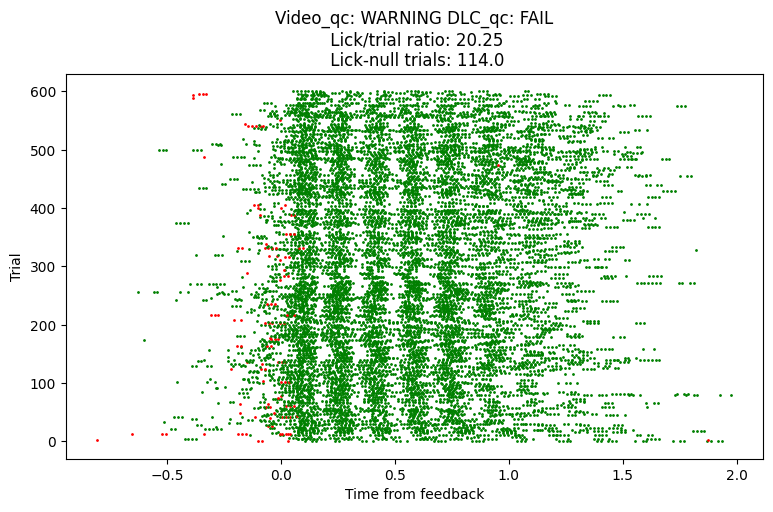

948fd27b-507b-41b3-bdf8-f9f5f0af8e0b


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

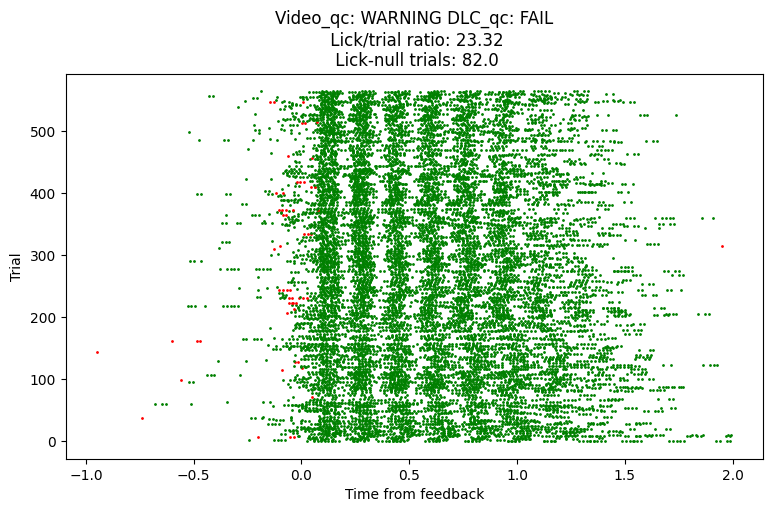

2e22c1fc-eec6-4856-85a0-7dba8668f646


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

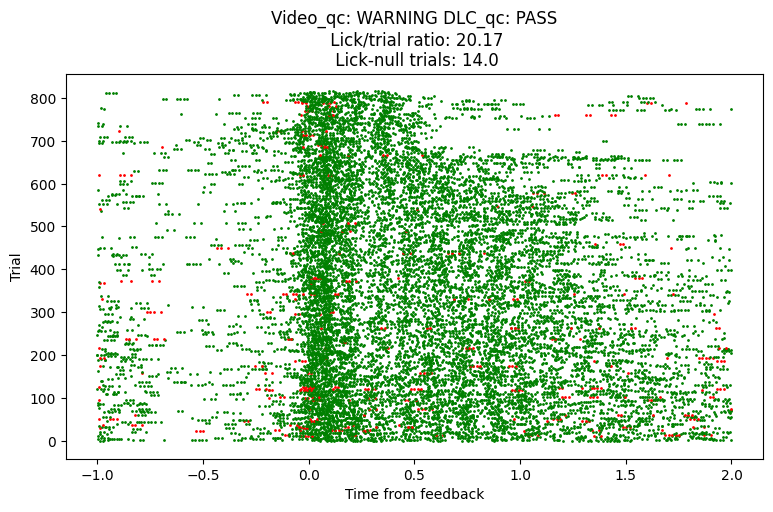

64977c74-9c04-437a-9ea1-50386c4996db


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

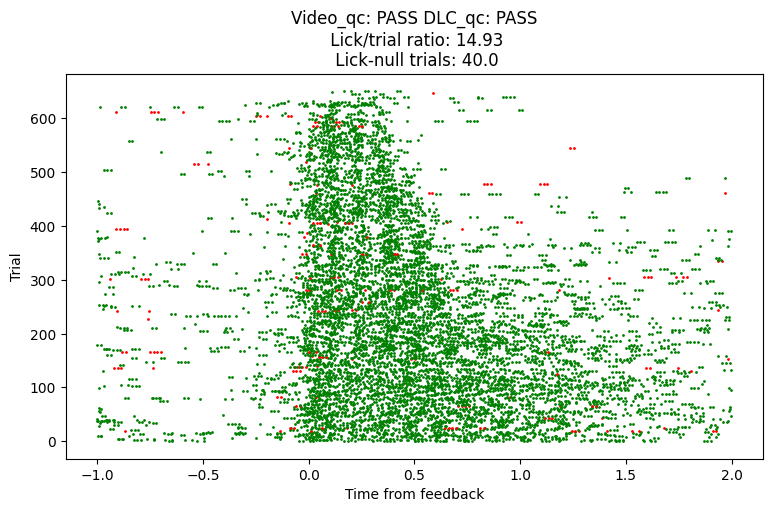

9a6e127b-bb07-4be2-92e2-53dd858c2762


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

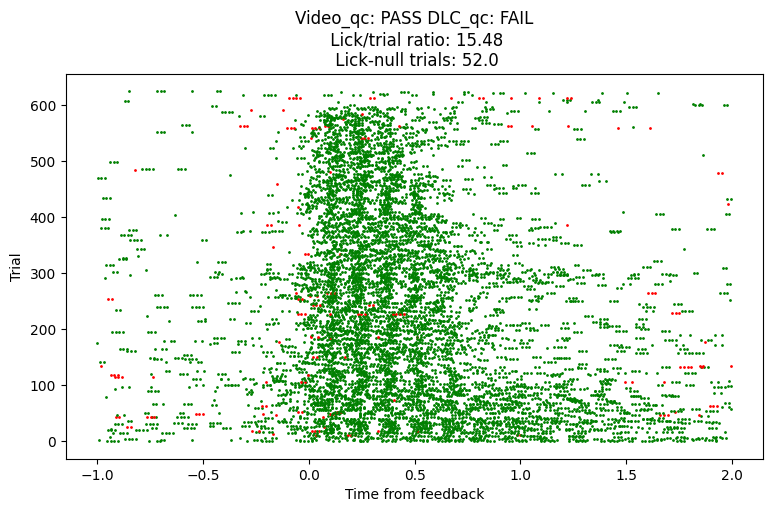

09156021-9a1d-4e1d-ae59-48cbde3c5d42


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

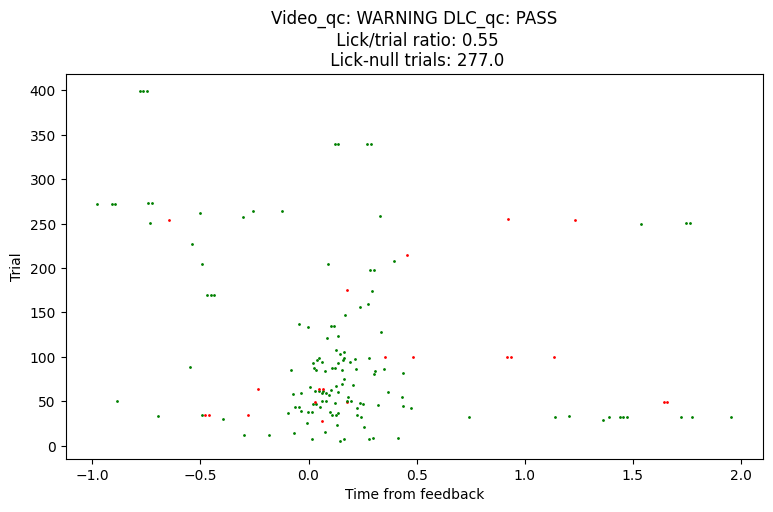

90e524a2-aa63-47ce-b5b8-1b1941a1223a


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

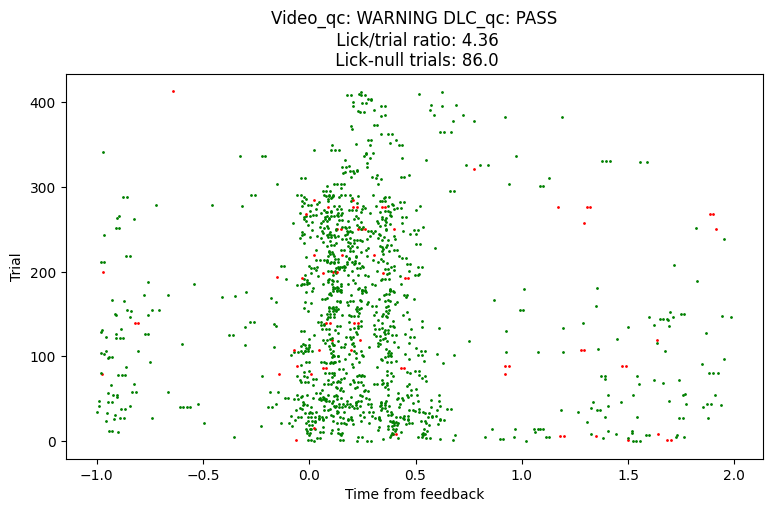

1d4a7bd6-296a-48b9-b20e-bd0ac80750a5


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

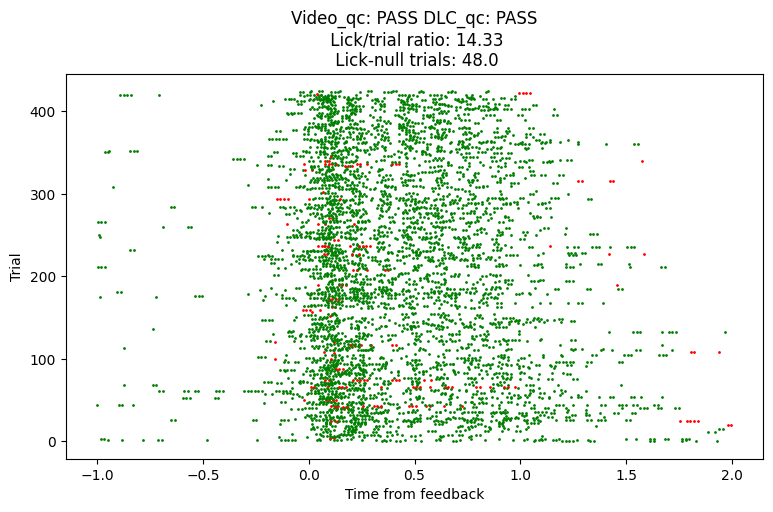

58c4bf97-ec3b-45b4-9db4-d5d9515d5b00


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

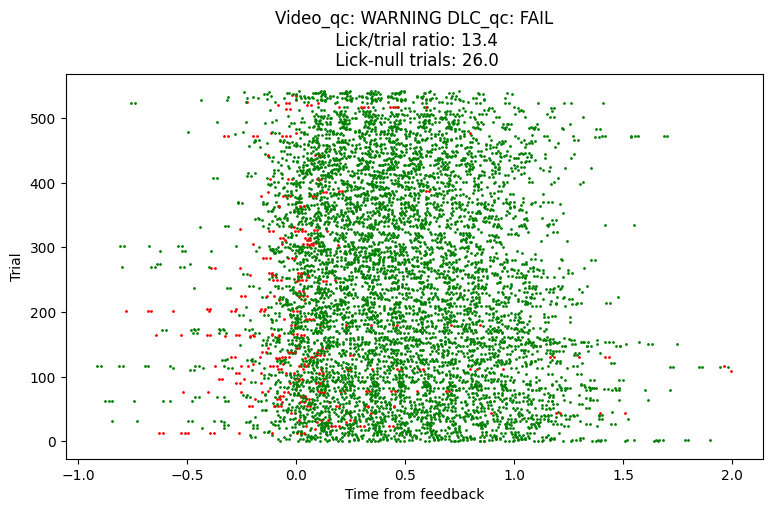

10fac7a1-919d-4ca7-83c4-4675bd8d9416


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

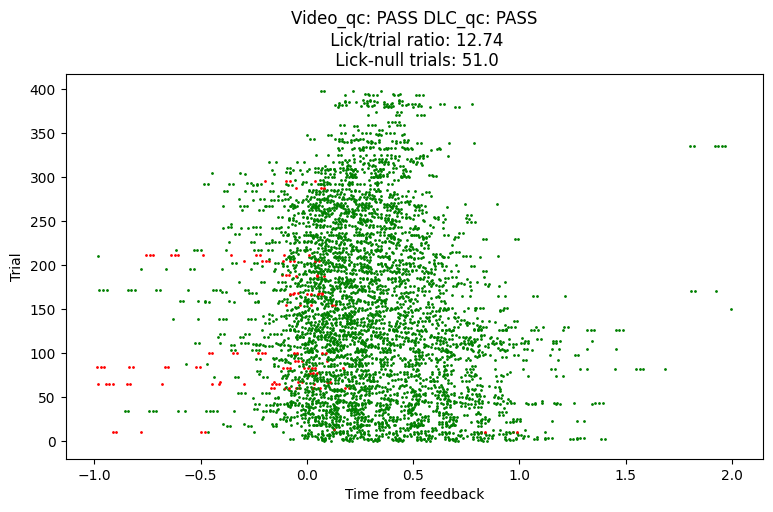

8b1f4024-3d96-4ee7-95f9-8a1dfd4ce4ef


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

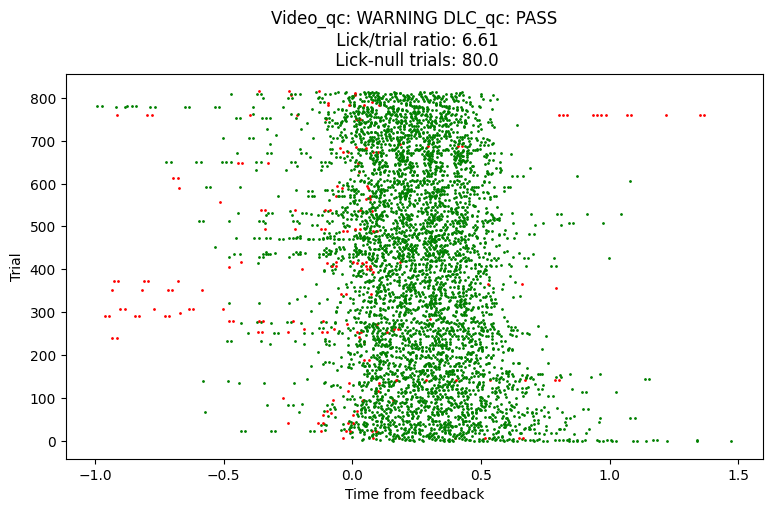

68775ca0-b056-48d5-b6ae-a4c2a76ae48f


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

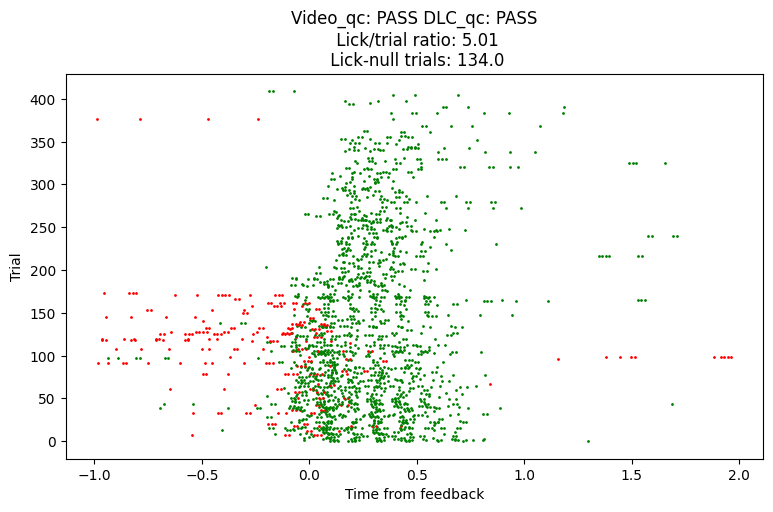

f27e6cd6-cdd3-4524-b8e3-8146046e2a7d


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

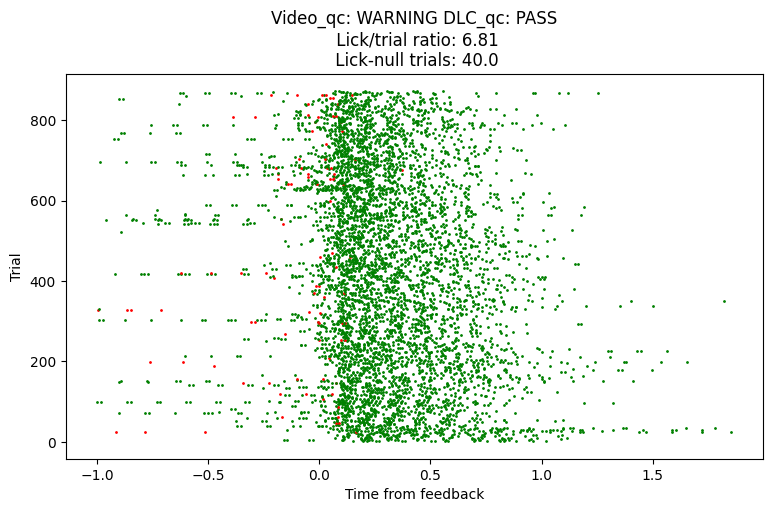

1b61b7f2-a599-4e40-abd6-3e758d2c9e25


/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  licks_df = licks_df.append(temp_df)
/home/ines/repositories/representation_learning_variability/Functions/video_functions.py:131: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use p

Could not plot for 30af8629-7b96-45b7-8778-374720ddbc5e


In [10]:
save_path = '/home/ines/repositories/representation_learning_variability/Video and wheel/Video QC/Figures/'

# use_filter = lick_custom.loc[(lick_custom['dlcLeft'].isin(['FAIL', 'CRITICAL', np.nan]))]
use_filter = lick_custom.loc[(lick_custom['dlcLeft'].isin(['FAIL', 'WARNING', np.nan, 'PASS'])) &
                             (lick_custom['videoLeft'].isin(['FAIL', 'WARNING', np.nan, 'PASS']))
                             ]

files = os.listdir(save_path)
eids = use_filter['eid'].unique()
for eid in eids:
    filename = str(eid + 'lick_psth_-12_feedback.png')
    # plot_licks(eid, lick_custom, psth_df, save_path)
    if filename not in files:
        try:
            plot_licks_PSTH(eid, lick_custom, save_path)
            print(eid)
        except:
            print('Could not plot for ' + eid)